# Project 1: Sex Differences in brain organization

### Main Script: Cortical Thickness

## Load packages

In [1]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv
import math
from math import isnan
import statistics
import pingouin as pg
import pickle

# Computing
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn
from brainstat.datasets import fetch_parcellation
from enigmatoolbox.permutation_testing import spin_test, shuf_test

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.2, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/sex_diff_gradients/data/'

resdir_gsp = '/data/p_02667/sex_diff_gradients/results/GSP/'
resdir_hcp = '/data/p_02667/sex_diff_gradients/results/HCP/'
resdir_fig = '/data/p_02667/sex_diff_gradients/results/figures/'

## Import functions

In [3]:
%run p1_myfunctions.ipynb

# Data 

## Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)



- **So a parcel cannot belong to more than 1 network..? LIMITATION NO? -> Yes. Shanmugan et al. (2022) for example use loading onto a network (i.e., not discrete)** 

In [4]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

with open(datadir+'yeo_7.csv') as f:
    reader = csv.reader(f)
    yeo7_networks = list(reader)[0]  # need [0] because the network values are contained in double brackets [[ ]]

Plotting the 7 Yeo networks on cortical surface

**TO DO:**
- no option of a map with 7 colors..? https://matplotlib.org/stable/tutorials/colors/colormaps.html
- there must be a better way of labelling the maps with actual names of networks (ie categorical)? maybe not, not the purpose of this plot hemispheres function


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


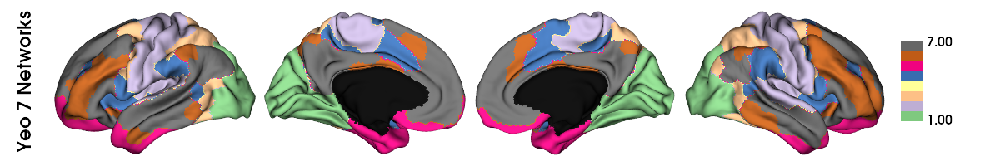

In [5]:
# need the the yeo network values (=dummy coding) to be in array format & float type in order to map_to_labels
yeo7_networks_array = []

for i in yeo7_networks:
    yeo7_networks_array.append(float(i))

yeo7_networks_array = np.asarray(yeo7_networks_array)



# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=networks, embed_nb = True, size=(1200, 200), cmap='Accent', color_bar=True, label_text=['Yeo 7 Networks'], zoom=1.55)


## Network labels ('Accent' cmap):
# 1 visual (green)
# 2 sensory motor (purple)
# 3 dorsal attention (beige)
# 4 ventral attention (blue)
# 5 limbic (fuchsia)
# 6 fronto parietal (brown)
# 7 DMN (grey)

This palette is to be used for every time that Yeo networks are displayed in color (except (a) for showing the networks plotted on the hemispheres - this dictionary doesn't work as cmap for plot_hemispheres; (b) the pie charts - dictionary format not recognized)

In [6]:
# original Yeo network colors
palette_labeled_networks = {'DMN': 'indianred',  
                            'dorsal attention' : 'forestgreen',  
                            'fronto parietal' : 'orange',  
                            'limbic' : 'lemonchiffon',  
                            'sensory motor' : 'steelblue',
                            'ventral attention' : 'orchid', 
                            'visual' : 'darkorchid'} 

This is not needed for the raincloud plot, just for the scatterplot G1 v G2 displaying networks

In [7]:
# making an array with yeo network labels (names instead of numbers)
yeo7_networks_array_labels = []

for i in yeo7_networks:
    if i == '1':
        yeo7_networks_array_labels.append('visual')
    elif i == '2':
        yeo7_networks_array_labels.append('sensory motor')
    elif i == '3':
        yeo7_networks_array_labels.append('dorsal attention')
    elif i == '4':
        yeo7_networks_array_labels.append('ventral attention')
    elif i == '5':
        yeo7_networks_array_labels.append('limbic')
    elif i == '6':
        yeo7_networks_array_labels.append('fronto parietal')
    elif i == '7':
        yeo7_networks_array_labels.append('DMN')

yeo7_networks_array_labels = np.asarray(yeo7_networks_array_labels)

In [8]:
network_names = ["visual", "sensory motor", "DMN", "dorsal attention", "ventral attention", "limbic", "fronto parietal"]

print("Number of parcels in each Yeo network:")
for i in range(len(network_names)):
    print(f"- {network_names[i]}: {yeo7_networks_array_labels.tolist().count(network_names[i])}")

Number of parcels in each Yeo network:
- visual: 61
- sensory motor: 77
- DMN: 90
- dorsal attention: 46
- ventral attention: 47
- limbic: 26
- fronto parietal: 53


## Fetch fsaverage parcellation (20484 vertices) coded for Schaefer 400 parcels - for Spin permutation tests

Spin permutation testing: https://enigma-toolbox.readthedocs.io/en/latest/pages/08.spintest/index.html -> requires data to be in fsaverage surface (not feasible with Schaefer parcellation)

**NOTE: schaefer_400_fs5 == 0 corresponds to midline (labels go from 0-400) -> disregard 0 in calculations and plotting**

In [9]:
# fetch the fsaverage parcellation labeling each of fsaverage5's 20484 vertices with its corresponding Schaefer parcel
schaefer_400_fs5 = fetch_parcellation("fsaverage5", "schaefer", 400)

## Import list of subjects (obtained from functional data -> subjects who have FC matrices)

In [10]:
GSP_sub_list = pd.read_csv(datadir+'GSP_sub_list.csv', header = None)[0].to_list()

In [11]:
HCP_sub_list = pd.read_csv(datadir+'HCP_sub_list.csv', header = None)[0].to_list()
HCP_sub_list = [str(e) for e in HCP_sub_list]  # making every subject ID number in the list a string in order to match the format of the variable HCP_sub_list as it was originally yielded when retrieving FC matrices

## Cortical Thickness data 

bianca_ct.mat file sent by Sofie - contains:
- GSP : 1570 subjects x 20484 vertices  # fsa5
- GSPdata : 1 -> weird file
- HCP : 1206 subjects x 20484 vertices  # fsa5
- HCPfs32k : 1206 subjects x 64984 vertices  # conte69 -> officially formatted HCP CT files, **use this!**
- HCPid : 1206 subjects


*Notes*
- *I noticed that, when mapping the vertices onto schaefer400 for a given subject, I don't get the same results with HCP (fsa5) and HCPfs32k (conte69) ... Decision with Sofie was to just use the officially formatted HCP files*


In [12]:
scipy.io.whosmat(datadir + 'bianca_ct.mat')

[('bianca_ct', (1, 1), 'struct'),
 ('__function_workspace__', (1, 1609736), 'uint8')]

In [13]:
# only taking the matrices from the mat file
bianca_ct = scipy.io.loadmat(datadir + 'bianca_ct.mat')['bianca_ct']

In [14]:
GSP_ct_20484 = bianca_ct[0][0][0]  # GSP : 1570 subjects x 20484 vertices # fsa5
#HCP_ct_20484 = bianca_ct[0][0][2]  # HCP : 1206 subjects x 20484 vertices # fsa5 
HCP_ct_64984 = bianca_ct[0][0][3]  # HCPfs32k : 1206 subjects x 64984 vertices # conte69

## Descriptive GSP

### Load data

In [15]:
GSP_demographics = pd.read_csv(datadir+'GSP/GSP_list_140630.csv')  
print(f'Sample with demographic data: N = {len(GSP_demographics)}')

#GSP_demographics.keys()

Sample with demographic data: N = 1570


### Making "cleaned" version of the demographics dataframe which only contains subjects who also have fc matrices

In [16]:
# making a list of only the numbers of subjects with fc matrices 
GSP_sub_list_numbers = []

for sub in GSP_sub_list:
    GSP_sub_list_numbers.append(sub[4:])
    
    
# create a new "cleaned" variable and set index as subject in order to drop subject rows by calling on subject ID
GSP_demographics_cleaned = GSP_demographics.set_index('Subject_ID')


# 2 subjects with fc matrices missing: 0008 and 1287
for subID in GSP_demographics.loc[:,'Subject_ID']:
    if str(str(subID)[3:7]) not in GSP_sub_list_numbers:
        GSP_demographics_cleaned = GSP_demographics_cleaned.drop(subID)
        

# creating and adding to the demographics dataframe a numerical variable for sex (for including sex as a covariate in partial correlation, throws error if include 'M' 'F' lables)
sex_num = []


for sex_letter in GSP_demographics_cleaned.Sex:
    
    if sex_letter == 'M':
        sex_num.append(0)
        
    elif sex_letter == 'F':
        sex_num.append(1)
        
    else:  # just in case, but there are none
        sex_num.append('n/a') 

GSP_demographics_cleaned['sex_num'] = sex_num
#GSP_demographics.sex_num.value_counts()

In [17]:
print(f"N = {len(GSP_demographics_cleaned)}\n"
      f"{np.sum(GSP_demographics_cleaned.Sex == 'F')} females, {np.sum(GSP_demographics_cleaned.Sex == 'M')} males\n"
      f"Mean subject age: {np.mean(GSP_demographics_cleaned.Age_Bin):.2f}, SD: {np.std(GSP_demographics_cleaned.Age_Bin):.2f}, range: {np.min(GSP_demographics_cleaned.Age_Bin):.2f} - {np.max(GSP_demographics_cleaned.Age_Bin):.2f}\n"
      f"Mean ICV: {np.mean(GSP_demographics_cleaned.ICV):.2f}, SD: {np.std(GSP_demographics_cleaned.ICV):.2f}, range: {np.min(GSP_demographics_cleaned.ICV):.2f} - {np.max(GSP_demographics_cleaned.ICV):.2f}")

N = 1568
905 females, 663 males
Mean subject age: 21.54, SD: 2.89, range: 19.00 - 35.00
Mean ICV: 1550645.44, SD: 148622.46, range: 1128895.08 - 2028048.55


### Export demographics dataframe to csv for R analyses
commented out because the most updated version is that containing global_ct (comes later in notebook)

### Testing differences in age between the sexes (given that I will test sex differences without matching for age)

In [18]:
# Levene's test for equality of variances -> non-significant differences means equality, can contiunue with parametric independent samples t-test
stats.levene(GSP_demographics_cleaned.Age_Bin[GSP_demographics_cleaned.Sex == 'M'], GSP_demographics_cleaned.Age_Bin[GSP_demographics_cleaned.Sex == 'F'])

LeveneResult(statistic=0.9402326681380857, pvalue=0.3323677474311486)

In [19]:
stats.ttest_ind(GSP_demographics_cleaned.Age_Bin[GSP_demographics_cleaned.Sex == 'M'], GSP_demographics_cleaned.Age_Bin[GSP_demographics_cleaned.Sex == 'F'])

Ttest_indResult(statistic=1.283186804764, pvalue=0.19961650062768793)

Text(0, 0.5, 'Frequency')

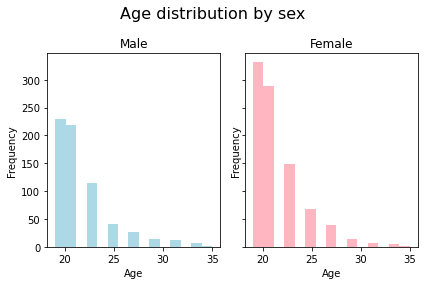

In [20]:
fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)

fig.suptitle('Age distribution by sex', fontsize=16)

axs[0].hist(GSP_demographics_cleaned.Age_Bin[GSP_demographics_cleaned.Sex == 'M'], bins=15, color = 'lightblue')
axs[0].set_title('Male')
axs[0].set_xlabel('Age')
axs[0].set_ylabel('Frequency')

axs[1].hist(GSP_demographics_cleaned.Age_Bin[GSP_demographics_cleaned.Sex == 'F'], bins=15, color = 'lightpink')
axs[1].set_title('Female')
axs[1].set_xlabel('Age')
axs[1].set_ylabel('Frequency')

## Descriptive HCP

### Load data

In [21]:
restricted_data = pd.read_csv(datadir+'RESTRICTED_wanb_9_29_2020_2_14_36.csv')  # contains ACTUAL age, race, ethnicity, handedness, income, education, menstrual cycle info
print(f'Sample with demographic (restricted) data: N = {len(restricted_data)}')

#restricted_data.keys()
#for i in restricted_data.keys():
#    print(i)

unrestricted_data = pd.read_csv(datadir+'unrestricted_wanb_9_14_2020_7_53_51.csv')  # sex ('gender'), BINNED age (in 5-year increments, 22-25, 26-30, 31-35, 35+), ICV ('FS_IntraCranial_Vol')
print(f'Sample with demographic (unrestricted) data: N = {len(unrestricted_data)}')

#unrestricted_data.keys
#for i in unrestricted_data.keys():
#    print(i)

Sample with demographic (restricted) data: N = 1206
Sample with demographic (unrestricted) data: N = 1206


### Making "cleaned" versions of the dataframes which only contain subjects who also have fc matrices

In [22]:
### restricted data

## set index as subject in order to drop subject rows by calling on subject ID
restricted_data_cleaned = restricted_data.set_index('Subject')

for subID in restricted_data.loc[:,'Subject']:
    if str(subID) not in HCP_sub_list:
        restricted_data_cleaned = restricted_data_cleaned.drop(subID)



### unrestricted data

## set index as subject in order to drop subject rows by calling on subject ID
unrestricted_data_cleaned = unrestricted_data.set_index('Subject')

for subID in unrestricted_data.loc[:,'Subject']:
    if str(subID) not in HCP_sub_list:
        unrestricted_data_cleaned = unrestricted_data_cleaned.drop(subID)
        
        
## creating and adding to the demographics dataframe a numerical variable for sex (for including sex as a covariate in partial correlation, throws error if include 'M' 'F' lables)
sex_num = []


for sex_letter in unrestricted_data_cleaned.Gender:
    
    if sex_letter == 'M':
        sex_num.append(0)
        
    elif sex_letter == 'F':
        sex_num.append(1)
        
    else:  # just in case, but there are none
        sex_num.append('n/a') 

unrestricted_data_cleaned['sex_num'] = sex_num
#unrestricted_data_cleaned.sex_num.value_counts()

### Creating a merged demographic dataframe (from restricted and unrestricted data)

In [23]:
# merge based on index of both left dataset (unrestricted) and right dataset (restricted)
HCP_demographics_cleaned = pd.merge(unrestricted_data_cleaned, restricted_data_cleaned, left_index=True, right_index=True)

### Creating a variable describing twin status (MZ, DZ, sibling, unrelated)

#### This is for linear mixed effect model -> controling for family and twin status 

In [24]:
### Make a list containing the family IDs that have multiple siblings

HCP_family_IDs = []  # contains all family IDs (without duplicates)
HCP_family_IDs_related = []  # contains family IDs of subjects that have relatives in sample ("duplicated" family IDs) - each ID appearing only 1x

# loop over all subjects
for i in range(len(HCP_demographics_cleaned)):
   
    # conditions to append family ID in HCP_family_IDs_related df:
    # if the current sub's family ID is already in the HCP_family_IDs, it means that we have looped over this family ID before therefore there are siblings sharing this family_ID in the dataset; AND
    # because we don't want duplicate family IDs in HCP_family_IDs_related: if the current sub's family ID is not yet in HCP_family_IDs_related -> we need to append it
    if (HCP_demographics_cleaned.Family_ID.iloc[i] in HCP_family_IDs) & (HCP_demographics_cleaned.Family_ID.iloc[i] not in HCP_family_IDs_related):
        HCP_family_IDs_related.append(HCP_demographics_cleaned.Family_ID.iloc[i])
    
    if HCP_demographics_cleaned.Family_ID.iloc[i] not in HCP_family_IDs: 
        HCP_family_IDs.append(HCP_demographics_cleaned.Family_ID.iloc[i])
        
        
        
### create a list containing (in order of participants) those that have other family members in the sample based on their family ID (if it is present in list HCP_family_IDs_related)

family_members_in_sample = []

for i in HCP_demographics_cleaned['Family_ID'] :
    if i in HCP_family_IDs_related:
        family_members_in_sample.append(1)
    else:
        family_members_in_sample.append(0)



### create a new variable variable that specifies the twin status (i.e., MZ, DZ, sibling, unrelated)
# based on family_members_in_sample and Zygosity variables 
    # ZygosityGT (determined via genotyping) should be given precedence over ZygositySR (self-reported) 
    # Genotyping was only done when both subjects in a twin pair to have HasGT=TRUE to have a value (if genotyping is not available for either of a twin pair, no values are given for ZygosityGT)
    # Non-twin subjects also do not have a value for ZygosityGT
    # Note that some subjects self-reported as dizygotic twins (ZygositySR='NotMZ') but genotyping established that they were monozygotic twins (thence ZygosityGT='MZ' for those subjects)
    # including the empty ZygosityGT condition so that ZygositySR does not override GT    

TwinStatus = []

for i in range(len(HCP_demographics_cleaned)):
    if family_members_in_sample[i] == 1:
        if HCP_demographics_cleaned.ZygosityGT.iloc[i] == 'MZ' or (HCP_demographics_cleaned.ZygosityGT.iloc[i] == ' ' and HCP_demographics_cleaned.ZygositySR.iloc[i] == 'MZ'):
            TwinStatus.append('MZ')
        elif HCP_demographics_cleaned.ZygosityGT.iloc[i] == 'DZ' or (HCP_demographics_cleaned.ZygosityGT.iloc[i] == ' ' and HCP_demographics_cleaned.ZygositySR.iloc[i] == 'NotMZ'):
            TwinStatus.append('DZ')
        else:
            TwinStatus.append('sibling')
    elif family_members_in_sample[i] == 0:
        TwinStatus.append('unrelated')

HCP_demographics_cleaned['TwinStatus'] = TwinStatus



### creating a numerical version of TwinStatus variable (for including TwinStatus as a covariate in partial correlation, throws error if include string lables)
TwinStatus_num = []


for twinstatus_letter in HCP_demographics_cleaned.TwinStatus:
    
    if twinstatus_letter == 'MZ':
        TwinStatus_num.append(0)
        
    elif twinstatus_letter == 'DZ':
        TwinStatus_num.append(1)
    
    elif twinstatus_letter == 'sibling':
        TwinStatus_num.append(2)
    
    elif twinstatus_letter == 'unrelated':
        TwinStatus_num.append(3)

HCP_demographics_cleaned['TwinStatus_num'] = TwinStatus_num
#HCP_demographics_cleaned.TwinStatus_num.value_counts()

In [25]:
# for some reason, the partial correlation does not work when including Family_ID large numbers (10 digits <) as covariate - therefore, here we create new family IDs starting from 1 (whilst of course preserving family relatedness)

# dictionary that will include the correspondance of original IDs and new IDs (only for related individuals, unrelated will be easily numbered on top)
fam_ID_correspondance_dict = {}

for i in range(len(HCP_family_IDs_related)):
    
    # create a new dictionary entry with the original family ID and it's new corresponding family ID (starting with 1 not to make any issue with zero) -> IDs going from 1 to 347 (as there are 347 related families in sample)
    fam_ID_correspondance_dict[HCP_family_IDs_related[i]] = i+1

    
# creating a new variable for dataframe which will contain the new family IDs     
Family_ID_num = []
n = 0  

# iterate over all family IDs
for family_id in restricted_data_cleaned.Family_ID:
    
    # if it's a family ID of a family that has related individuals in sample, go fetch its new family ID in the dictionary and append it to the list
    if family_id in HCP_family_IDs_related:
        Family_ID_num.append(fam_ID_correspondance_dict[family_id])
    
    # if it's the family ID of an unrelated individual, create a new family ID by adding n to the len(family_related) (i.e., 347) - n is also being incremented each time we come across an unrelated subject in loop
    else:
        n += 1
        Family_ID_num.append(len(HCP_family_IDs_related)+n) # new family IDs for unrelated individuals

HCP_demographics_cleaned['Family_ID_num'] = Family_ID_num

In [26]:
print(f"N = {len(HCP_demographics_cleaned)}\n"
      f"{np.sum(HCP_demographics_cleaned.Gender == 'F')} females, {np.sum(HCP_demographics_cleaned.Gender == 'M')} males\n"
      f"Mean subject age: {np.mean(HCP_demographics_cleaned.Age_in_Yrs):.2f}, SD: {np.std(HCP_demographics_cleaned.Age_in_Yrs):.2f}, range: {np.min(HCP_demographics_cleaned.Age_in_Yrs):.2f} - {np.max(HCP_demographics_cleaned.Age_in_Yrs):.2f}\n"
      f"Mean ICV: {np.mean(HCP_demographics_cleaned.FS_IntraCranial_Vol):.2f}, SD: {np.std(HCP_demographics_cleaned.FS_IntraCranial_Vol):.2f}, range: {np.min(HCP_demographics_cleaned.FS_IntraCranial_Vol):.2f} - {np.max(HCP_demographics_cleaned.FS_IntraCranial_Vol):.2f}\n"
      f"Sample relatedness: {np.sum(HCP_demographics_cleaned.TwinStatus == 'MZ')} MZ twins, {np.sum(HCP_demographics_cleaned.TwinStatus == 'DZ')} DZ twins, {np.sum(HCP_demographics_cleaned.TwinStatus == 'sibling')} other siblings, {np.sum(HCP_demographics_cleaned.TwinStatus == 'unrelated')} unrelated individuals"
     )

N = 1014
544 females, 470 males
Mean subject age: 28.74, SD: 3.71, range: 22.00 - 37.00
Mean ICV: 1583398.49, SD: 186723.28, range: 831208.30 - 2143193.92
Sample relatedness: 293 MZ twins, 186 DZ twins, 452 other siblings, 83 unrelated individuals


### Export demographics dataframe to csv for R analyses
commented out because the most updated version is that containing global_ct (comes later in notebook)

### Testing differences in age between the sexes (given that I will test sex differences without matching for age)

In [27]:
# Levene's test for equality of variances -> non-significant differences means equality, can contiunue with parametric independent samples t-test
stats.levene(HCP_demographics_cleaned.Age_in_Yrs[HCP_demographics_cleaned.Gender == 'M'], HCP_demographics_cleaned.Age_in_Yrs[HCP_demographics_cleaned.Gender == 'F'])

LeveneResult(statistic=0.14932057395328685, pvalue=0.6992667192352071)

In [28]:
stats.ttest_ind(HCP_demographics_cleaned.Age_in_Yrs[HCP_demographics_cleaned.Gender == 'M'], HCP_demographics_cleaned.Age_in_Yrs[HCP_demographics_cleaned.Gender == 'F'])

Ttest_indResult(statistic=-7.069267321913692, pvalue=2.899004078650321e-12)

Text(0, 0.5, 'Frequency')

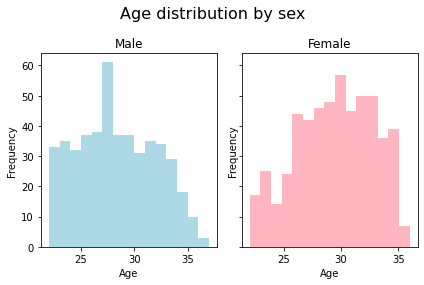

In [29]:
fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)

fig.suptitle('Age distribution by sex', fontsize=16)

axs[0].hist(HCP_demographics_cleaned.Age_in_Yrs[HCP_demographics_cleaned.Gender == 'M'], bins=15, color = 'lightblue')
axs[0].set_title('Male')
axs[0].set_xlabel('Age')
axs[0].set_ylabel('Frequency')

axs[1].hist(HCP_demographics_cleaned.Age_in_Yrs[HCP_demographics_cleaned.Gender == 'F'], bins=15, color = 'lightpink')
axs[1].set_title('Female')
axs[1].set_xlabel('Age')
axs[1].set_ylabel('Frequency')

# Reshape CT data from fsa5 to Schaefer 400

## GSP

In [30]:
## run function to reshape CT data from surface-level (fsa5; 20484 vertices) to parcellated-level (Schaefer 400 format; 400 parcels) - function yields a dictionary
reshape_output_GSP_ct_schaefer400 = reshape_surface_to_parcel_for_all_subjects(surface_level_across_subs = GSP_ct_20484, surface_atlas_to_parcellation = 'schaefer_400_fsa5')


## store dictionary output into variables

# CT data in Schaefer 400 format for all subjects -> array shaped: 1568 x 400
GSP_ct_schaefer400 = reshape_output_GSP_ct_schaefer400['parcel_level_all_subs']

# global CT (mean CT across parcels) for each subject
GSP_global_ct = reshape_output_GSP_ct_schaefer400['mean_across_parcels']

### Remove subjects with missing fc matrices from structural analysis so that sample is the same across analyses

Upon prior inspection of the data (in demographic data section), subjects 0008 and 1287 were found to have missing matrices -> removing them from CT data to analyze

In [31]:
# indexes to be removed: subject 8 -1 (7) and subject 1287 -1 (1286) 
# BUT CAREFUL -> remove first index 1286 and then 8 (in order to preserve the position of subjects in the list: otherwise I mess up the indexing by deleting first subjects first)


## CT data in Schaefer 400 format

# need to convert array to list in order to use del
GSP_ct_schaefer400 = GSP_ct_schaefer400.tolist()

# delete sublist (of 400 parcel CT values) based on index
del GSP_ct_schaefer400[1286]
del GSP_ct_schaefer400[7]

# reconvert into array
GSP_ct_schaefer400 = np.array(GSP_ct_schaefer400)


## global CT (already in list format)

del GSP_global_ct[1286]
del GSP_global_ct[7]

### Make a new column in demographics dataframe with global CT value for each subject and exporting it for R analyses

In [32]:
GSP_demographics_cleaned['global_ct'] = GSP_global_ct

GSP_demographics_cleaned.to_csv(resdir_gsp+'demographics_cleaned.csv', header = True, index = True)

### Storing Schaefer 400 CT data in different arrays by sex

In [33]:
# creating lists containing only male and only female CT values (for 400 parcels)
GSP_ct_schaefer400_M = []  # 663
GSP_ct_schaefer400_F = []  # 905

for i in range(len(GSP_ct_schaefer400)):
    if GSP_demographics_cleaned.Sex.iloc[i] == "M":
        GSP_ct_schaefer400_M.append(GSP_ct_schaefer400[i])
    elif GSP_demographics_cleaned.Sex.iloc[i] == "F":
        GSP_ct_schaefer400_F.append(GSP_ct_schaefer400[i])
        
# make the variables containing Schaefer 400 CT data by sex into arrays
GSP_ct_schaefer400_M = np.array(GSP_ct_schaefer400_M) 
GSP_ct_schaefer400_F = np.array(GSP_ct_schaefer400_F) 

In [34]:
# creating demographics dataframes by sex (in order to call on those for the covariates when doing the partial correlations)
GSP_demographics_cleaned_M = GSP_demographics_cleaned[GSP_demographics_cleaned.Sex == 'M']
GSP_demographics_cleaned_F = GSP_demographics_cleaned[GSP_demographics_cleaned.Sex == 'F']

## HCP

In [35]:
## run function to reshape CT data from surface-level (conte; 64984 vertices) to parcellated-level (Schaefer 400 format; 400 parcels) - function yields a dictionary
reshape_output_HCP_ct_schaefer400 = reshape_surface_to_parcel_for_all_subjects(surface_level_across_subs = HCP_ct_64984, surface_atlas_to_parcellation = 'schaefer_400_conte69')


## store dictionary output into variables

# CT data in Schaefer 400 format for all subjects -> array shaped: 1568 x 400
HCP_ct_schaefer400 = reshape_output_HCP_ct_schaefer400['parcel_level_all_subs']

# global CT (mean CT across parcels) for each subject
HCP_global_ct = reshape_output_HCP_ct_schaefer400['mean_across_parcels']

### Remove subjects with missing fc matrices from structural analysis so that sample is the same across analyses

In [36]:
### identifying which subjects have missing fc matrices (their indices, given that subject order is preserved across demographics, FC data, CT data)

# creating a list -> indices to be removed in structural data
indices_missing_fc = []

# to keep track of current iteration number (will be used as reference of index for subjects with missing fc matrices)
count_index = 0  

# iterating over all 1206 subjects (original sample)
for subID in restricted_data.loc[:,'Subject']:
    
    # if subject ID from the original sample is not in the HCP_sub_list (containing the subject IDs of subjects who have fc matrices), then add the current location of the subject ID in list (index) to the indices_missing_fc list
    if str(subID) not in HCP_sub_list:
        indices_missing_fc.append(count_index)
    
    # increment the index count (only at the end of loop so that first index = 0 and can actually be used as an index
    count_index += 1

# sorting the list of indices to be removed into descending order (in order to preserve the position of subjects in the list: otherwise I mess up the indexing by deleting first subjects first)
indices_missing_fc.sort(reverse = True)

    
### remove subjects (via their indices) who do not have fc matrices

# need to convert CT data array to list in order to use del
HCP_ct_schaefer400 = HCP_ct_schaefer400.tolist()

# iterate over the list of missing indices to delete sublist (of 400 parcel CT values) based on index, as well as deleting global CT values also based on index
for i in indices_missing_fc:
    del HCP_ct_schaefer400[i]
    del HCP_global_ct[i]

# reconvert into array
HCP_ct_schaefer400 = np.array(HCP_ct_schaefer400)

### Make a new column in demographics dataframe with global CT value for each subject and exporting it for R analyses

In [37]:
HCP_demographics_cleaned['global_ct'] = HCP_global_ct

HCP_demographics_cleaned.to_csv(resdir_hcp+'demographics_cleaned.csv', header = True, index = True)

### Storing Schaefer 400 CT data in different arrays by sex

In [38]:
# creating lists containing only male and only female CT values (for 400 parcels)
HCP_ct_schaefer400_M = []  # 470
HCP_ct_schaefer400_F = []  # 544

for i in range(len(HCP_ct_schaefer400)):
    if HCP_demographics_cleaned.Gender.iloc[i] == "M":
        HCP_ct_schaefer400_M.append(HCP_ct_schaefer400[i])
    elif HCP_demographics_cleaned.Gender.iloc[i] == "F":
        HCP_ct_schaefer400_F.append(HCP_ct_schaefer400[i])
        
# make the variables containing Schaefer 400 CT data by sex into arrays
HCP_ct_schaefer400_M = np.array(HCP_ct_schaefer400_M) 
HCP_ct_schaefer400_F = np.array(HCP_ct_schaefer400_F) 

In [39]:
# creating demographics dataframes by sex (in order to call on those for the covariates when doing the partial correlations)
HCP_demographics_cleaned_M = HCP_demographics_cleaned[HCP_demographics_cleaned.Gender == 'M']
HCP_demographics_cleaned_F = HCP_demographics_cleaned[HCP_demographics_cleaned.Gender == 'F']

## Exporting local CT for R analyses

In [40]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir_gsp+'ct_schaefer400.csv', GSP_ct_schaefer400, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'ct_schaefer400.csv', HCP_ct_schaefer400, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

In [41]:
GSP_ct_schaefer400.shape

(1568, 400)

# Mean local CT

## Across sexes

In [86]:
# compute mean CT
GSP_ct_schaefer400_mean = np.mean(GSP_ct_schaefer400, axis = 0)
HCP_ct_schaefer400_mean = np.mean(HCP_ct_schaefer400, axis = 0)

In [87]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)  #len(labeling) = 64984 (i.e., conte69? at least matches as works with conte69 hemispheres)
surf_lh, surf_rh = load_conte69()
mask = labeling != 0  # do not consider 0 labels which correspond to the midline

### GSP

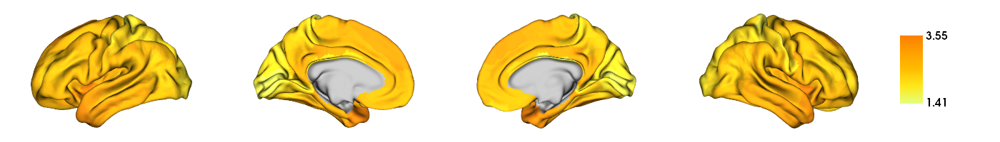

In [164]:
GSP_ct_mapped_to_labels = map_to_labels(GSP_ct_schaefer400_mean, labeling, mask=mask, fill=np.nan) 

GSP_ct_plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = GSP_ct_mapped_to_labels, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'Wistia', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    #label_text = ["overlap of significant sex differences"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'GSP_local_ct_plotted_hemispheres_mean_across_sexes.png')

GSP_ct_plotted_hemispheres

### HCP

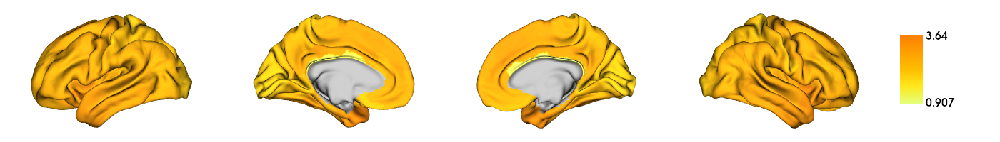

In [167]:
HCP_ct_mapped_to_labels = map_to_labels(HCP_ct_schaefer400_mean, labeling, mask=mask, fill=np.nan) 

HCP_ct_plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = HCP_ct_mapped_to_labels, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'Wistia', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    #label_text = ["overlap of significant sex differences"],
    zoom = 1.45, 
    screenshot = False,
    filename = resdir_fig+'HCP_local_ct_plotted_hemispheres_mean_across_sexes.png')

HCP_ct_plotted_hemispheres

## By sex

In [125]:
# make subsets of ct_schaefer400 containing only males and only females
GSP_ct_schaefer400_M = GSP_ct_schaefer400[GSP_demographics_cleaned["Sex"] == 'M']
GSP_ct_schaefer400_F = GSP_ct_schaefer400[GSP_demographics_cleaned["Sex"] == 'F']
HCP_ct_schaefer400_M = HCP_ct_schaefer400[HCP_demographics_cleaned["Gender"] == 'M']
HCP_ct_schaefer400_F = HCP_ct_schaefer400[HCP_demographics_cleaned["Gender"] == 'F']

In [126]:
# take the mean across sex (and sample)
GSP_ct_schaefer400_M_mean = np.mean(GSP_ct_schaefer400_M, axis = 0)
GSP_ct_schaefer400_F_mean = np.mean(GSP_ct_schaefer400_F, axis = 0)
HCP_ct_schaefer400_M_mean = np.mean(HCP_ct_schaefer400_M, axis = 0)
HCP_ct_schaefer400_F_mean = np.mean(HCP_ct_schaefer400_F, axis = 0)

### plot on hemispheres with harmonized color range for CT values --> for supplements?

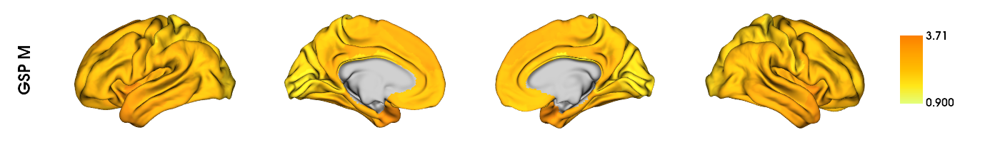

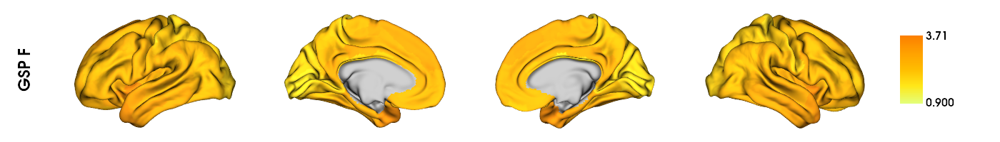

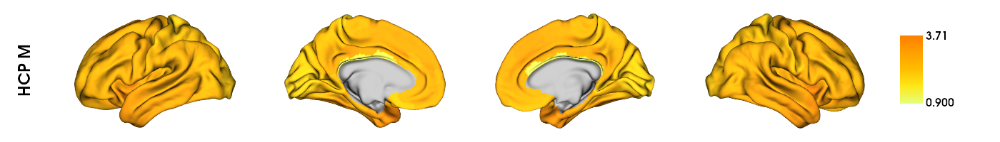

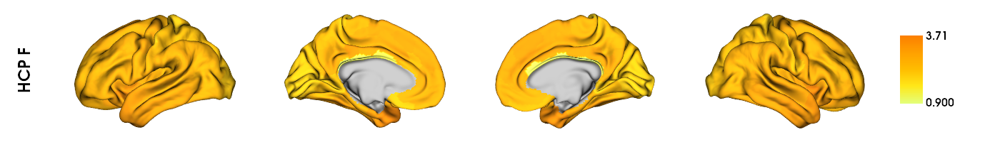

In [169]:
handles = []

color_range = (0.9,3.71)

GSP_ct_mapped_to_labels = map_to_labels(GSP_ct_schaefer400_M_mean, labeling, mask=mask, fill=np.nan)

GSP_ct_plotted_hemispheres = plot_hemispheres(
    surf_lh,
    surf_rh,
    array_name = GSP_ct_mapped_to_labels,
    embed_nb = True,
    size = (1400,200),
    cmap = 'Wistia',
    color_bar = True,
    color_range = color_range,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["GSP M"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'GSP_local_ct_plotted_hemispheres_mean_M.png')

handles.append(GSP_ct_plotted_hemispheres)


GSP_ct_mapped_to_labels = map_to_labels(GSP_ct_schaefer400_F_mean, labeling, mask=mask, fill=np.nan)

GSP_ct_plotted_hemispheres = plot_hemispheres(
    surf_lh,
    surf_rh,
    array_name = GSP_ct_mapped_to_labels,
    embed_nb = True,
    size = (1400,200),
    cmap = 'Wistia',
    color_bar = True,
    color_range = color_range,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["GSP F"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'GSP_local_ct_plotted_hemispheres_mean_F.png')


handles.append(GSP_ct_plotted_hemispheres)


HCP_ct_mapped_to_labels = map_to_labels(HCP_ct_schaefer400_M_mean, labeling, mask=mask, fill=np.nan)

HCP_ct_plotted_hemispheres = plot_hemispheres(
    surf_lh,
    surf_rh,
    array_name = HCP_ct_mapped_to_labels,
    embed_nb = True,
    size = (1400,200),
    cmap = 'Wistia',
    color_bar = True,
    color_range = color_range,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["HCP M"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HCP_local_ct_plotted_hemispheres_mean_M.png')

handles.append(HCP_ct_plotted_hemispheres)


HCP_ct_mapped_to_labels = map_to_labels(HCP_ct_schaefer400_F_mean, labeling, mask=mask, fill=np.nan)

HCP_ct_plotted_hemispheres = plot_hemispheres(
    surf_lh,
    surf_rh,
    array_name = HCP_ct_mapped_to_labels,
    embed_nb = True,
    size = (1400,200),
    cmap = 'Wistia',
    color_bar = True,
    color_range = color_range,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["HCP F"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HCP_local_ct_plotted_hemispheres_mean_F.png')

handles.append(HCP_ct_plotted_hemispheres)


display(*handles) 

### Males vs Females

#### GSP

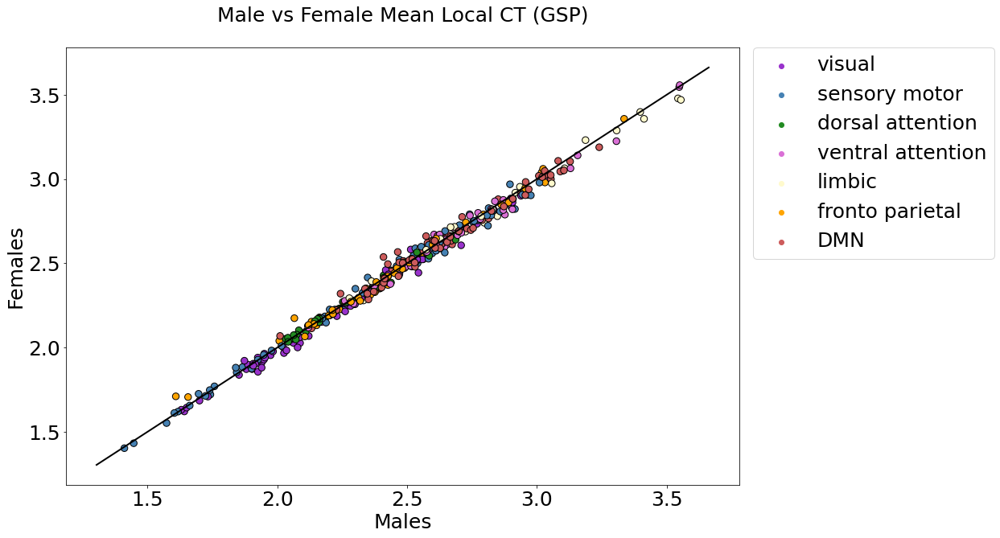

In [76]:
# plotting GSP mean CT
plot_mean_parcel_values_scatter_bysex(male_data = GSP_ct_schaefer400_M_mean, female_data = GSP_ct_schaefer400_F_mean, title = 'Mean Local CT (GSP)')

#### HCP

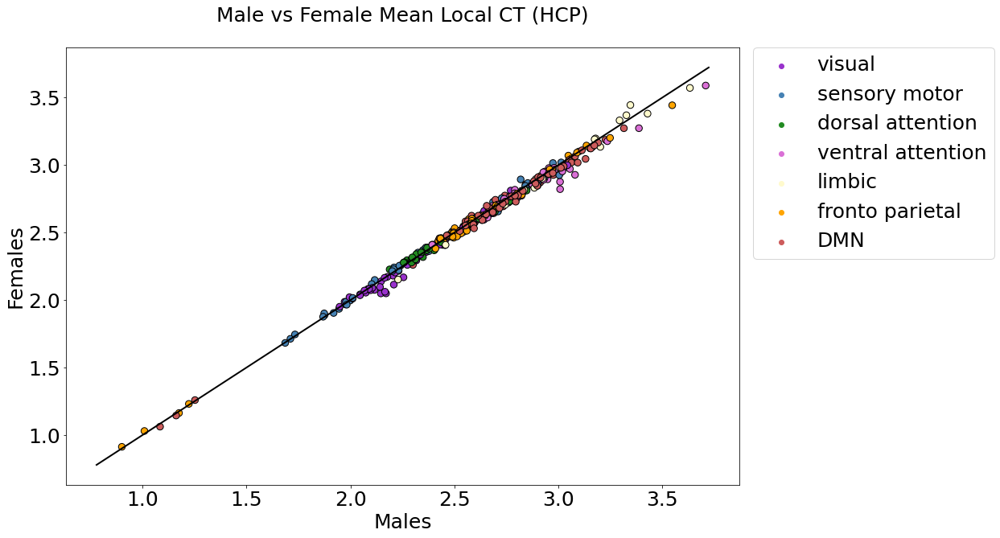

In [78]:
# plotting HCP mean CT
plot_mean_parcel_values_scatter_bysex(male_data = HCP_ct_schaefer400_M_mean, female_data = HCP_ct_schaefer400_F_mean, title = 'Mean Local CT (HCP)')

# Sex effects local CT (standard linear regression - FDR-corrected)

In [4]:
# loading R results

# GSP model: linear model = Gradient_loadings ~ Sex + Age + Global CT 
GSP_R_lm_ct_local_sex_contrast_res = pd.read_csv(resdir_gsp+'R_lm_ct_local_sex_contrast_res.csv')  

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + Global CT + random effect family relatedness + random effect twin status + random effect (family relatedness * twin status) 
HCP_R_lmer_ct_local_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_ct_local_sex_contrast_res.csv')  

## GSP

Number of significant parcels: 179

Number of significant parcels for males: 99
Number of significant parcels for females: 80

Number of significant parcels in each Yeo network (across sexes):
- visual: 32 out of 61 (52.46%) -> 17.88% of overall significance
- sensory motor: 34 out of 77 (44.16%) -> 18.99% of overall significance
- DMN: 42 out of 90 (46.67%) -> 23.46% of overall significance
- dorsal attention: 13 out of 46 (28.26%) -> 7.26% of overall significance
- ventral attention: 23 out of 47 (48.94%) -> 12.85% of overall significance
- limbic: 15 out of 26 (57.69%) -> 8.38% of overall significance
- fronto parietal: 20 out of 53 (37.74%) -> 11.17% of overall significance





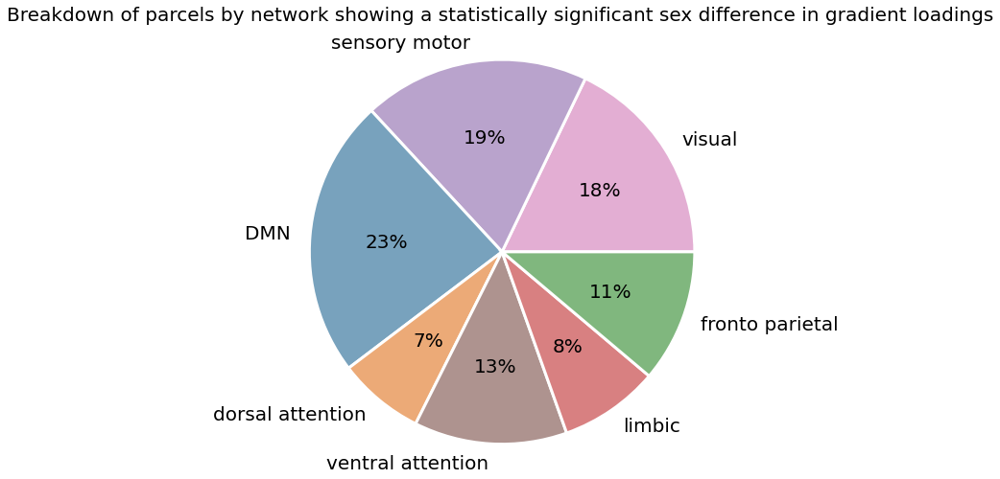

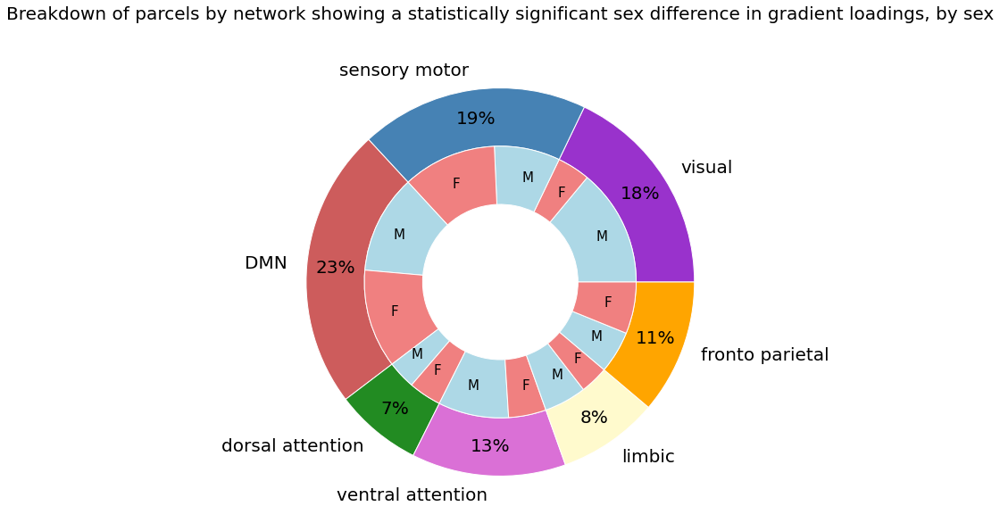

Number of significant parcels by sex:
visual - Male: 25, Female: 7
sensory motor - Male: 14, Female: 20
DMN - Male: 21, Female: 21
dorsal attention - Male: 6, Female: 7
ventral attention - Male: 15, Female: 8
limbic - Male: 9, Female: 6
fronto parietal - Male: 9, Female: 11





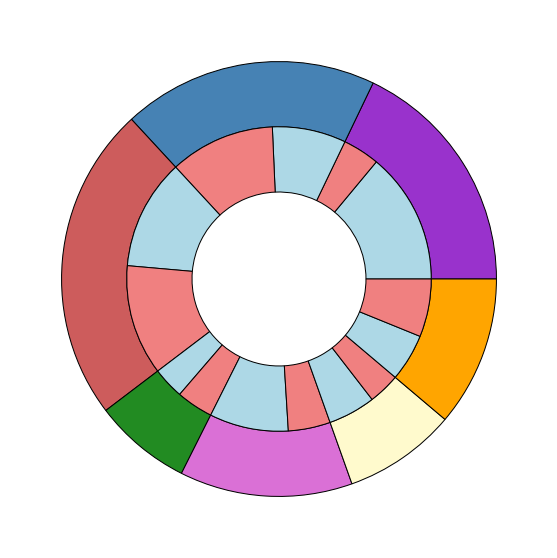




Violin plot of t-values (regression results) by Yeo network


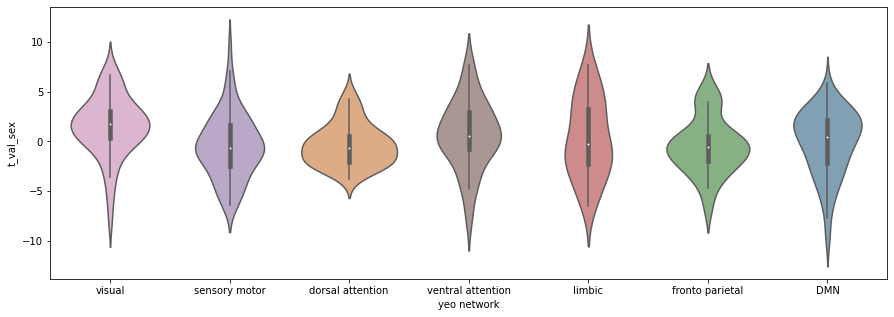

In [214]:
regression_contrast_results_breakdown_by_network(GSP_R_lm_ct_local_sex_contrast_res, contrast_type = 'sex', scatterplot = False, sample_modality = 'GSP_local_ct')

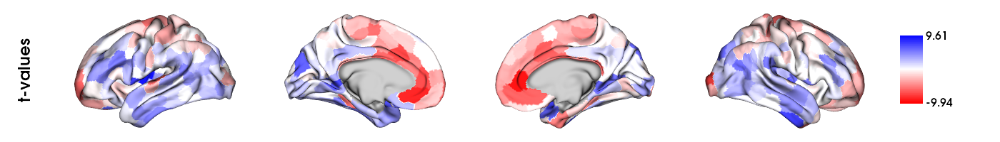

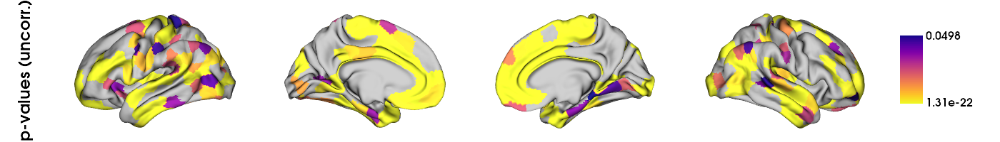

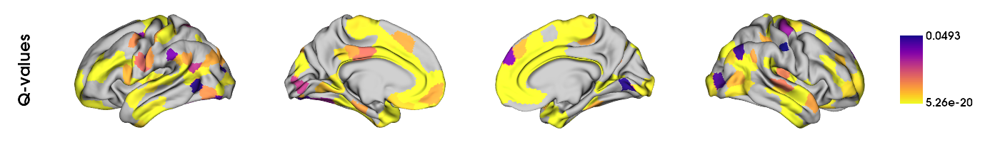

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

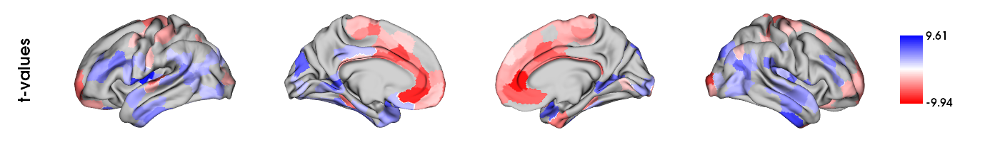

In [220]:
plots_to_display = plot_reg_results_R(GSP_R_lm_ct_local_sex_contrast_res, save_screenshot = False, sample_modality = 'GSP_local_ct')
display(*plots_to_display)

## HCP

Number of significant parcels: 159

Number of significant parcels for males: 74
Number of significant parcels for females: 85

Number of significant parcels in each Yeo network (across sexes):
- visual: 20 out of 61 (32.79%) -> 12.58% of overall significance
- sensory motor: 34 out of 77 (44.16%) -> 21.38% of overall significance
- DMN: 28 out of 90 (31.11%) -> 17.61% of overall significance
- dorsal attention: 20 out of 46 (43.48%) -> 12.58% of overall significance
- ventral attention: 22 out of 47 (46.81%) -> 13.84% of overall significance
- limbic: 14 out of 26 (53.85%) -> 8.81% of overall significance
- fronto parietal: 21 out of 53 (39.62%) -> 13.21% of overall significance





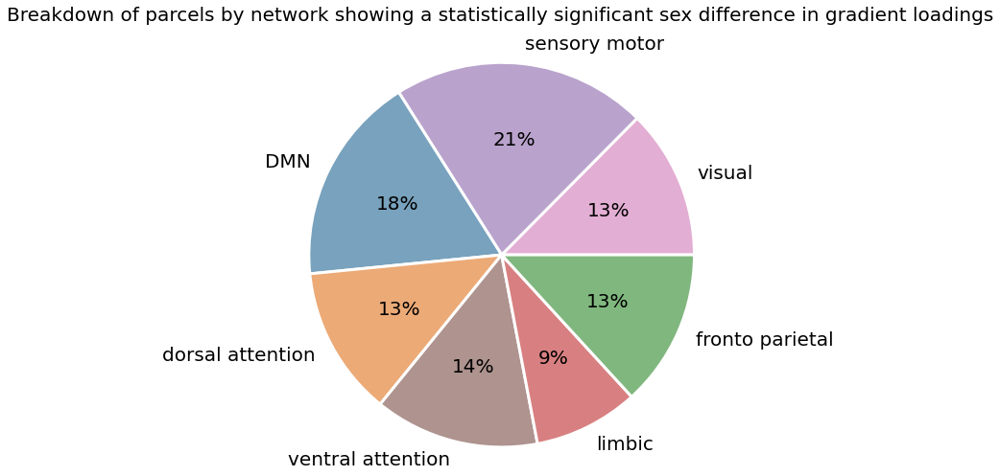

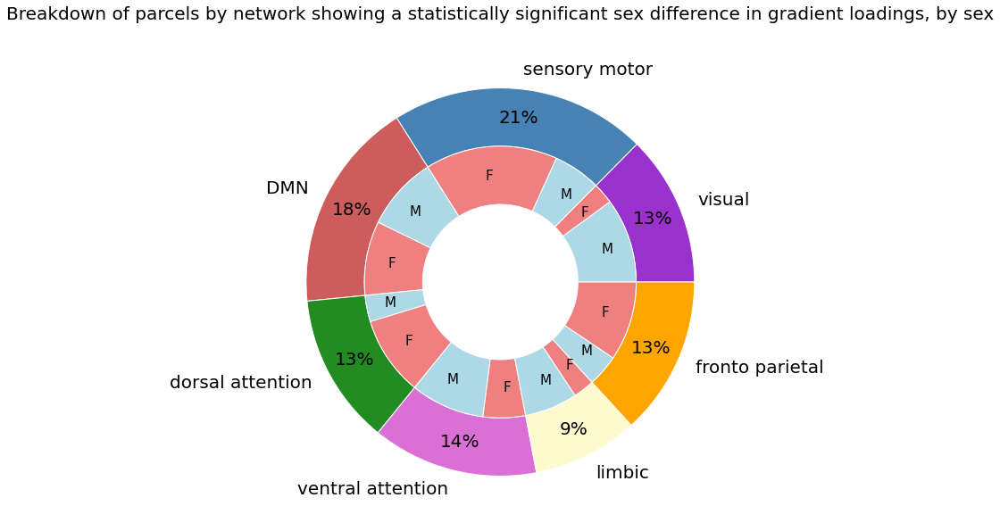

Number of significant parcels by sex:
visual - Male: 16, Female: 4
sensory motor - Male: 9, Female: 25
DMN - Male: 14, Female: 14
dorsal attention - Male: 5, Female: 15
ventral attention - Male: 14, Female: 8
limbic - Male: 10, Female: 4
fronto parietal - Male: 6, Female: 15





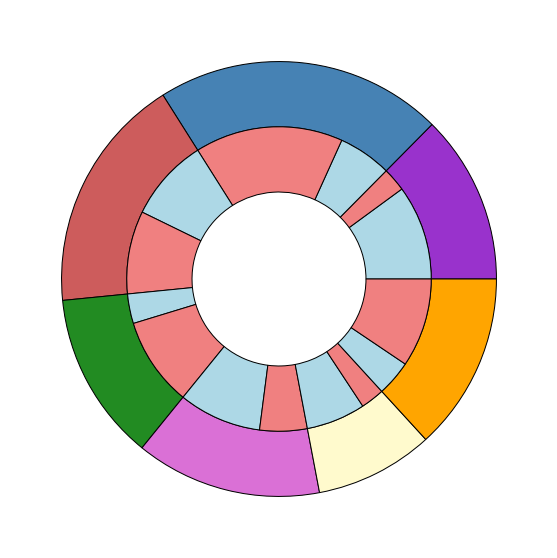




Violin plot of t-values (regression results) by Yeo network


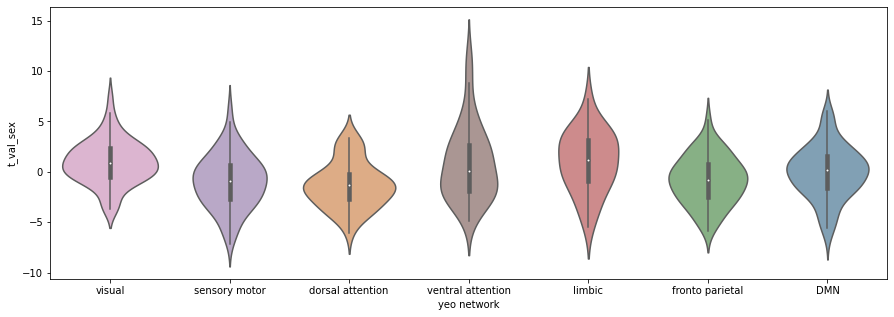

In [157]:
regression_contrast_results_breakdown_by_network(HCP_R_lmer_ct_local_sex_contrast_res, contrast_type = 'sex', scatterplot = False, sample_modality = 'HCP_local_ct')

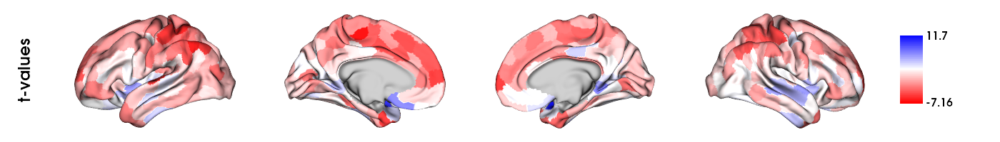

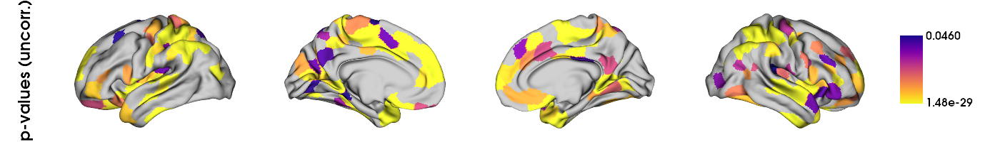

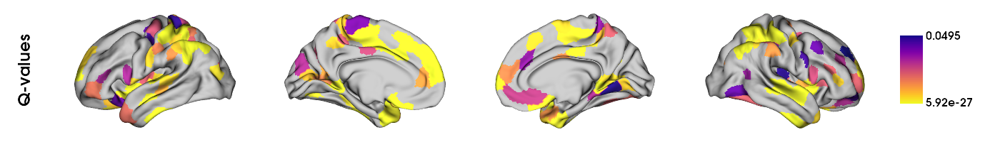

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

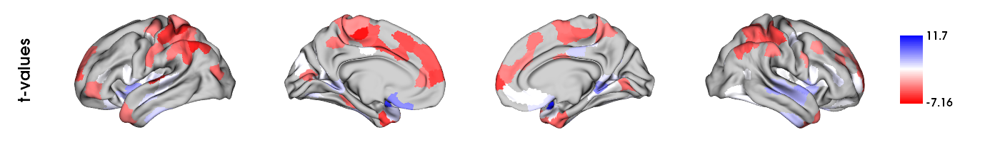

In [222]:
plots_to_display = plot_reg_results_R(HCP_R_lmer_ct_local_sex_contrast_res, save_screenshot = False, sample_modality = 'HCP_local_ct')
display(*plots_to_display)

# Comparing structural (CT) results between GSP and HCP samples

## Sex differences (local CT)

### Correlation t-values

Overall Pearson correlation between GSP sex contrast local CT t-values and HCP sex contrast local CT t-values: r = 0.53; p = 0.0

visual: r = 0.57, p = 0.0
sensory motor: r = 0.65, p = 0.0
dorsal attention: r = 0.42, p = 0.003
ventral attention: r = 0.58, p = 0.0
limbic: r = 0.35, p = 0.082
fronto parietal: r = 0.41, p = 0.002
DMN: r = 0.45, p = 0.0




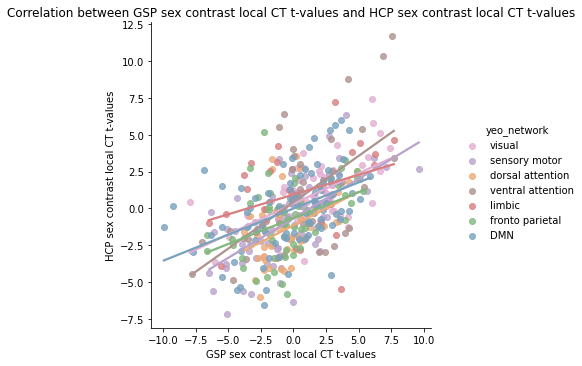

In [141]:
print_plot_corr_networks(x = GSP_R_lm_ct_local_sex_contrast_res.t_val_sex, y = HCP_R_lmer_ct_local_sex_contrast_res.t_val_sex, x_label = 'GSP sex contrast local CT t-values', y_label = 'HCP sex contrast local CT t-values')

### Spin permutation test (for correlation of t-values)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.002


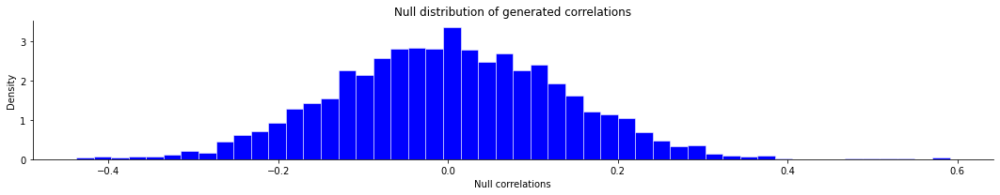

In [142]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_R_lm_ct_local_sex_contrast_res.t_val_sex, y = HCP_R_lmer_ct_local_sex_contrast_res.t_val_sex)

### Comparing parcels showing statistically significant sex differences between datasets

Number of parcels that show statistically significant sex differences across datasets: 80
Number of parcels that show statistically significant sex differences in GSP local CT only: 99
Number of parcels that show statistically significant sex differences in HCP local CT only: 79
Number of parcels (out of the 80 parcels that show sig sex differences in both datasets) which show sex differences in opposite directions: 7



'Overlap of significant sex differences: 2 (dark green): significant in both samples, 1 (light green): significant in one sample, 0: not significant'

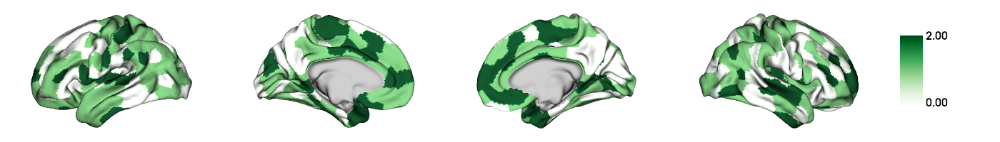

'Which dataset shows significant sex difference: +1 (red) GSP local CT, -1 (green) = HCP local CT, 0 (yellow) = both datasets, nan (grey) = not significant in any dataset'

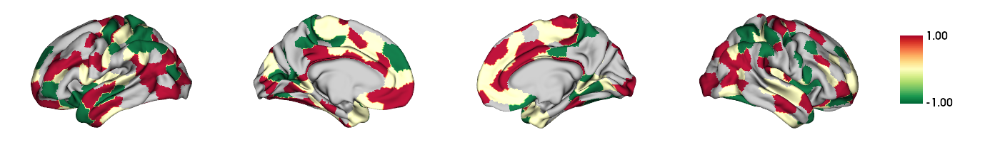

'Parcels showing sex differences in opposite directions'

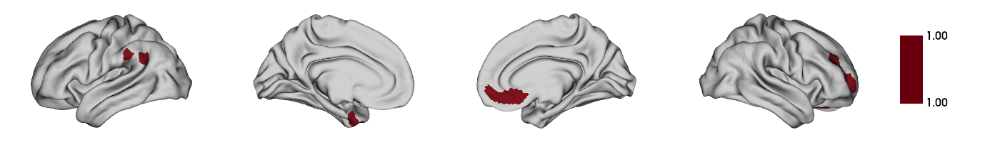

'mean t-values for overlapping significant parcels (FDR-corrected, q < 0.05) across samples (male: blue, female: red)'

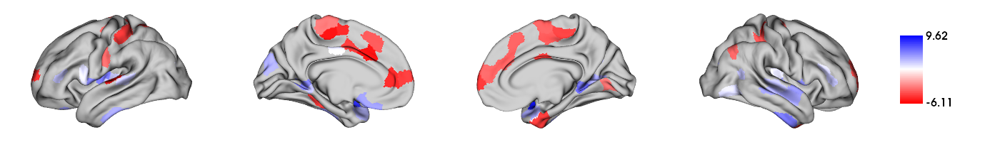

In [10]:
plots_to_display = plot_sig_overlap(reg_res_sample_1 = GSP_R_lm_ct_local_sex_contrast_res, reg_res_sample_2 = HCP_R_lmer_ct_local_sex_contrast_res, sample_1_label = "GSP local CT", sample_2_label = "HCP local CT", save_screenshot = False, modality = 'local_ct')
display(*plots_to_display)

### Visualizing t-values of sex contrast in unimodal-heteromodal gradient by network

Minimum positive significant t-value in GSP: 2.29
Minimum negative significant t-value in GSP: -2.31

Number of positive significant t-values (M > F (gradient loadings)) in GSP: 99 -> by network: {'visual': 25, 'sensory motor': 14, 'dorsal attention': 6, 'ventral attention': 15, 'limbic': 9, 'fronto parietal': 9, 'DMN': 21}
Number of negative significant t-values (F > M (gradient loadings)) in GSP: 80 -> by network: {'visual': 7, 'sensory motor': 20, 'dorsal attention': 7, 'ventral attention': 8, 'limbic': 6, 'fronto parietal': 11, 'DMN': 21}


Minimum positive significant t-value in HCP: 2.35
Minimum negative significant t-value in HCP: -2.34

Number of positive significant t-values (M > F (gradient loadings)) in HCP: 74 -> by network: {'visual': 16, 'sensory motor': 9, 'dorsal attention': 5, 'ventral attention': 14, 'limbic': 10, 'fronto parietal': 6, 'DMN': 14}
Number of negative significant t-values (F > M (gradient loadings)) in HCP: 85 -> by network: {'visual': 4, 'sensory motor'

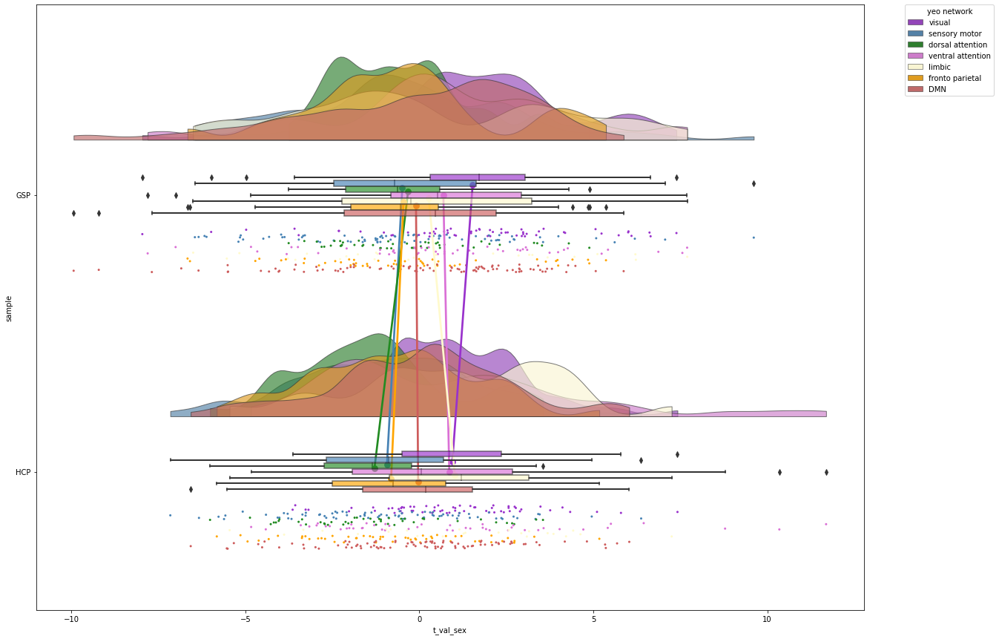

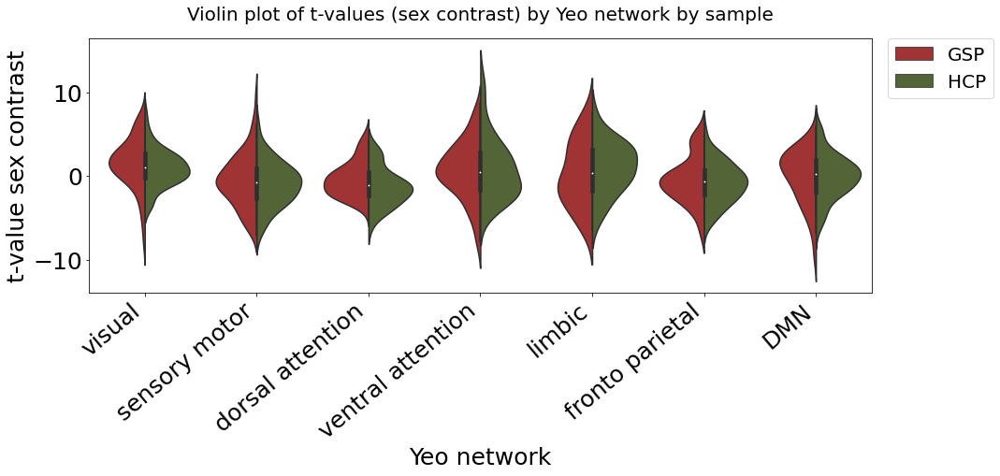

In [178]:
RainCloudPlot_YeoNetworks_SampleComparison_tval(reg_res_sample_1 = GSP_R_lm_ct_local_sex_contrast_res, reg_res_sample_2 = HCP_R_lmer_ct_local_sex_contrast_res, sample_1_label = "GSP", sample_2_label = "HCP")

#
#
#
# EXTRA -> move to supplementary?
#

# Structural CT gradients - i.e., individual level

## Structural (CT) matrices (one matrix per subjects)

#### **!! ATTENTION !!** Calculation of matrices takes about 15 min to run per dataset
Therefore commented out the actual matrix calculation and exportation -> importing the saved matrices instead (in fact, function was not run on MPI computer because made it crash - ran it on my laptop and imported the results in csv format here)

#### Export CT similarity matrices using pickel (because they are a 3D array: N x parcels x parcels)

#### Load CT similarity matrices (using pickle reader -> load)

In [42]:
# GSP
pkl_file = open(datadir+'ct_matrices/GSP/GSP_ct_matrices.pkl', 'rb')
GSP_ct_matrices = pickle.load(pkl_file)
pkl_file.close()

# HCP
pkl_file = open(datadir+'ct_matrices/HCP/HCP_ct_matrices.pkl', 'rb')
HCP_ct_matrices = pickle.load(pkl_file)
pkl_file.close()

## Structural (CT) gradients (individual level)

### Mean gradients

*Needed for figures and for computing aligned gradients*

#### GSP

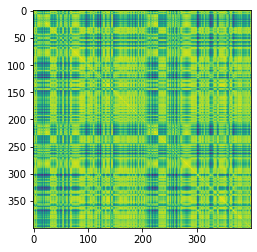

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


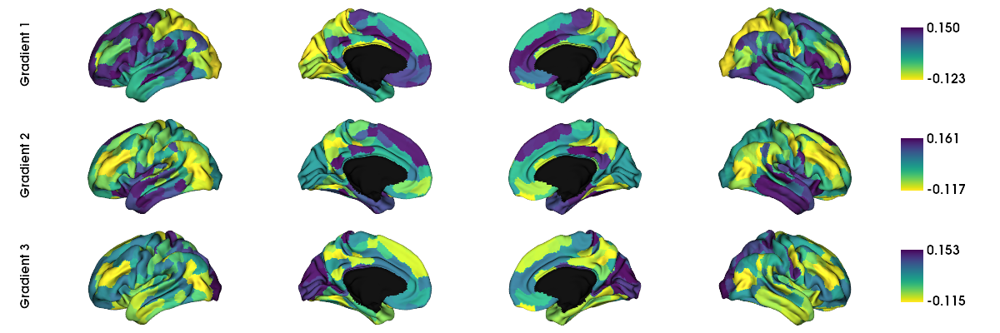

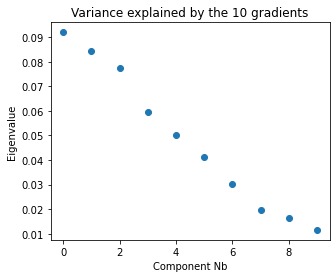

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.48

Scaled variance explained by individual gradients:
G1: 19.05%
G2: 17.45%
G3: 16.06%



In [74]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
GSP_mean_ct_matrix = sum(GSP_ct_matrices)/len(GSP_ct_matrices)

# compute mean gradients
GSP_mean_ct_grad = compute_mean_gradients(mean_conn_matrix = GSP_mean_ct_matrix, display_output = True, data_reduction_algorithm = 'dm')

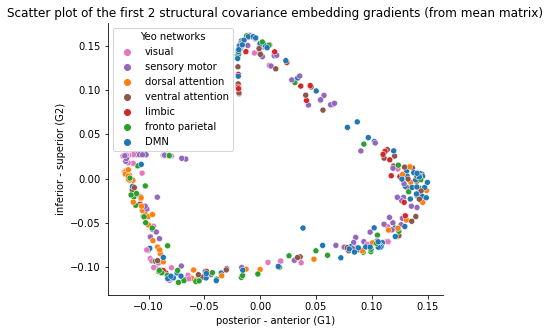

In [75]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=GSP_mean_ct_grad.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=GSP_mean_ct_grad.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

#### HCP

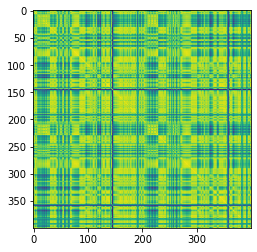

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


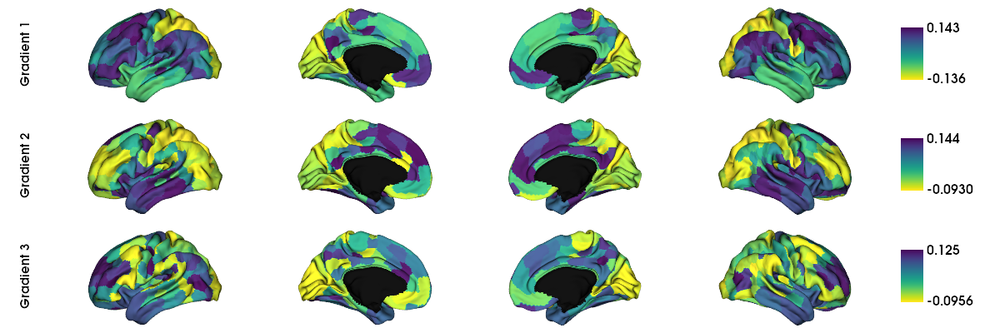

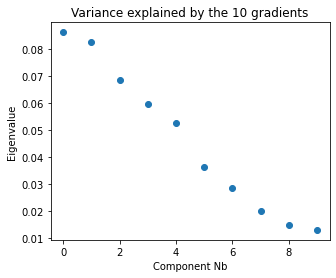

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.46

Scaled variance explained by individual gradients:
G1: 18.69%
G2: 17.89%
G3: 14.81%



In [76]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
HCP_mean_ct_matrix = sum(HCP_ct_matrices)/len(HCP_ct_matrices)

# compute mean gradients
HCP_mean_ct_grad = compute_mean_gradients(mean_conn_matrix = HCP_mean_ct_matrix, display_output = True, data_reduction_algorithm = 'dm')

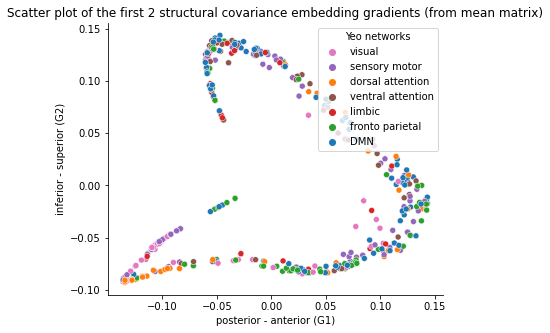

In [77]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=HCP_mean_ct_grad.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=HCP_mean_ct_grad.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [78]:
GSP_compute_aligned_ct_grad = compute_aligned_gradients(GSP_ct_matrices, GSP_mean_ct_grad.gradients_)

# storing the output of the computation of the aligned gradients
GSP_array_aligned_ct_G1 = GSP_compute_aligned_ct_grad['array_aligned_G1']
GSP_array_aligned_ct_G2 = GSP_compute_aligned_ct_grad['array_aligned_G2']

In [79]:
HCP_compute_aligned_ct_grad = compute_aligned_gradients(HCP_ct_matrices, HCP_mean_ct_grad.gradients_)

# storing the output of the computation of the aligned gradients
HCP_array_aligned_ct_G1 = HCP_compute_aligned_ct_grad['array_aligned_G1']
HCP_array_aligned_ct_G2 = HCP_compute_aligned_ct_grad['array_aligned_G2']

#### Exporting Gradients to csv for R analyses

In [80]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir_gsp+'array_aligned_ct_G1.csv', GSP_array_aligned_ct_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_gsp+'array_aligned_ct_G2.csv', GSP_array_aligned_ct_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

np.savetxt(resdir_hcp+'array_aligned_ct_G1.csv', HCP_array_aligned_ct_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'array_aligned_ct_G2.csv', HCP_array_aligned_ct_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

### Mean gradients by sex

*Needed for plotting (mean) Males vs (mean) Females (initially for fc the aim was to replicate this figure from Hong et al https://www.nature.com/articles/s41467-019-08944-1/figures/3*)

#### GSP

In [81]:
# creating lists containing only male and only female fc matrices

GSP_ct_matrices_M = []
GSP_ct_matrices_F = []

for i in range(len(GSP_ct_matrices)):
    if GSP_demographics_cleaned.Sex.iloc[i] == "M":
        GSP_ct_matrices_M.append(GSP_ct_matrices[i])
    elif GSP_demographics_cleaned.Sex.iloc[i] == "F":
        GSP_ct_matrices_F.append(GSP_ct_matrices[i])

#### Males

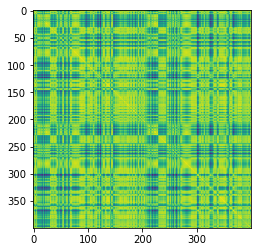

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


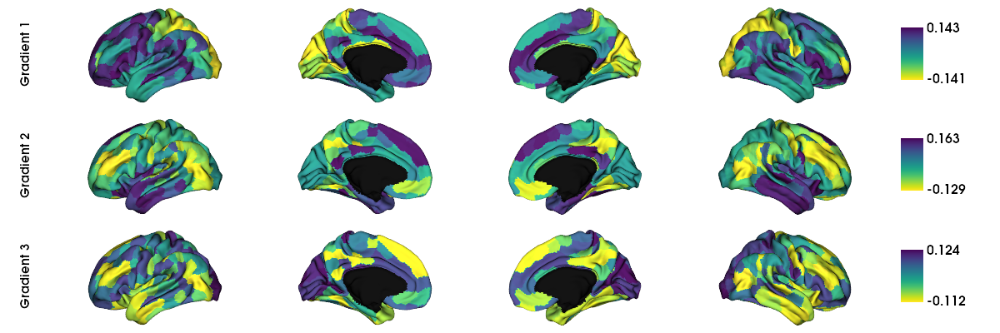

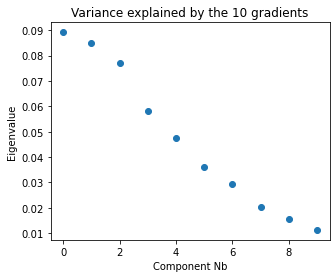

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.47

Scaled variance explained by individual gradients:
G1: 19.00%
G2: 18.09%
G3: 16.38%



In [82]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all males)
GSP_mean_ct_matrix_M = sum(GSP_ct_matrices_M)/len(GSP_ct_matrices_M)

# compute mean gradients
GSP_mean_ct_grad_M = compute_mean_gradients(mean_conn_matrix = GSP_mean_ct_matrix_M, display_output = True, data_reduction_algorithm = 'dm')

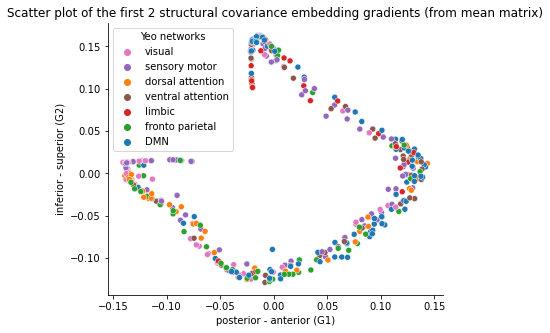

In [83]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=GSP_mean_ct_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=GSP_mean_ct_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

#### Females

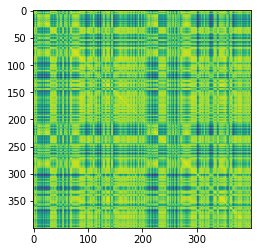

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


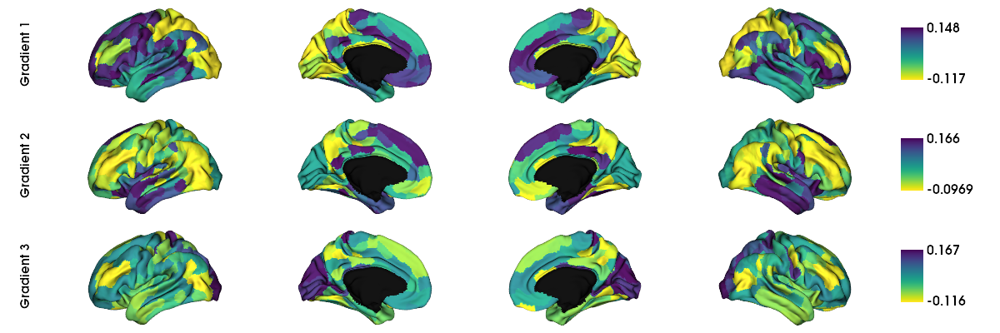

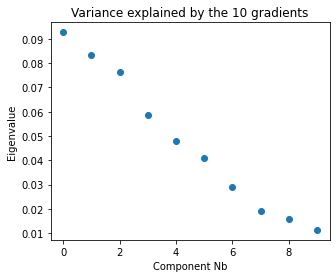

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.48

Scaled variance explained by individual gradients:
G1: 19.51%
G2: 17.55%
G3: 16.04%



In [84]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all females)
GSP_mean_ct_matrix_F = sum(GSP_ct_matrices_F)/len(GSP_ct_matrices_F)

# compute mean gradients
GSP_mean_ct_grad_F = compute_mean_gradients(mean_conn_matrix = GSP_mean_ct_matrix_F, display_output = True, data_reduction_algorithm = 'dm')

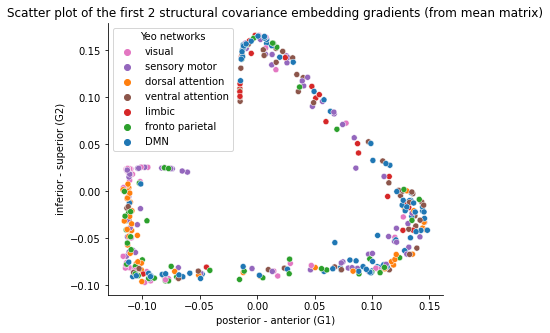

In [85]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=GSP_mean_ct_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=GSP_mean_ct_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

#### HCP

In [86]:
# creating lists containing only male and only female fc matrices

HCP_ct_matrices_M = []
HCP_ct_matrices_F = []

for i in range(len(HCP_ct_matrices)):
    if HCP_demographics_cleaned.Gender.iloc[i] == "M":
        HCP_ct_matrices_M.append(HCP_ct_matrices[i])
    elif HCP_demographics_cleaned.Gender.iloc[i] == "F":
        HCP_ct_matrices_F.append(HCP_ct_matrices[i])

#### Males

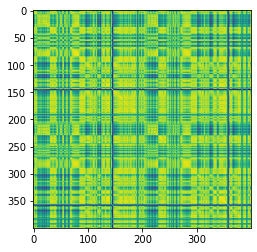

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


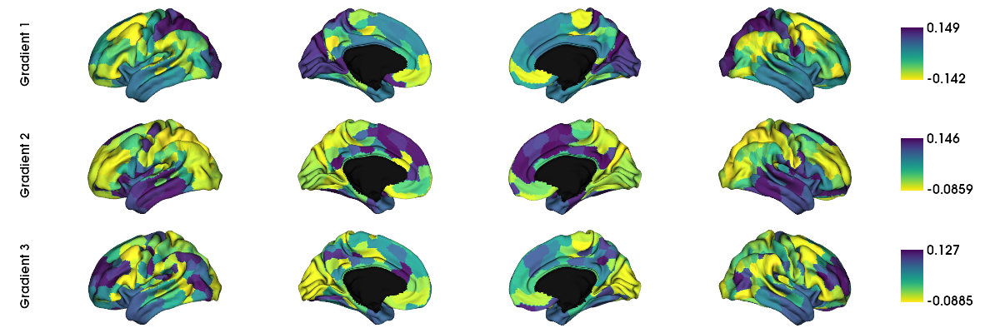

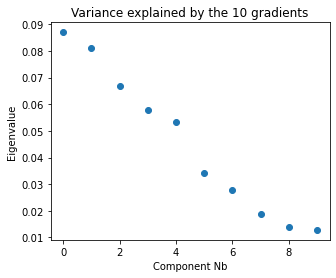

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.45

Scaled variance explained by individual gradients:
G1: 19.18%
G2: 17.88%
G3: 14.70%



In [87]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all males)
HCP_mean_ct_matrix_M = sum(HCP_ct_matrices_M)/len(HCP_ct_matrices_M)

# compute mean gradients
HCP_mean_ct_grad_M = compute_mean_gradients(mean_conn_matrix = HCP_mean_ct_matrix_M, display_output = True, data_reduction_algorithm = 'dm')

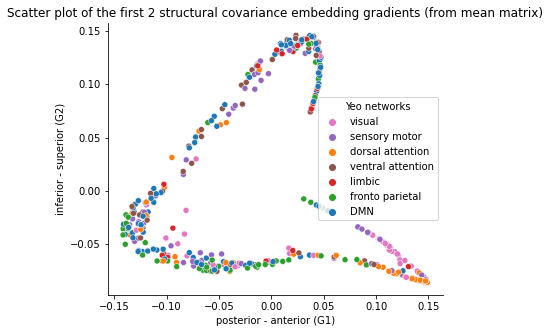

In [88]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=HCP_mean_ct_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=HCP_mean_ct_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

#### Females

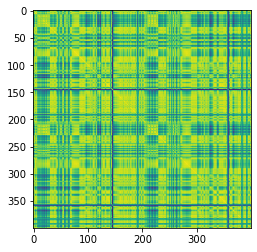

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


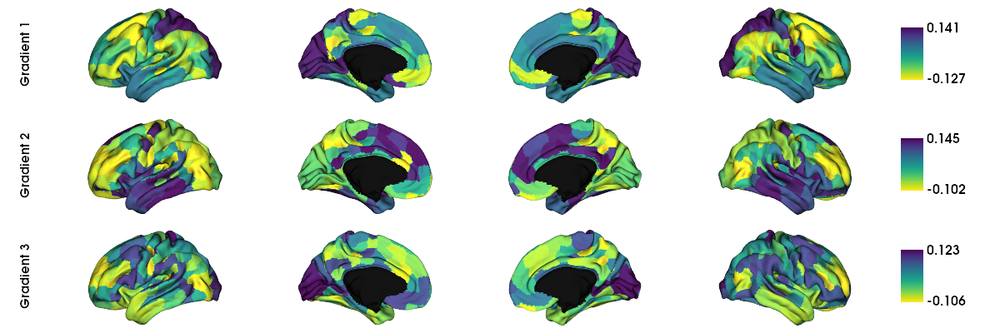

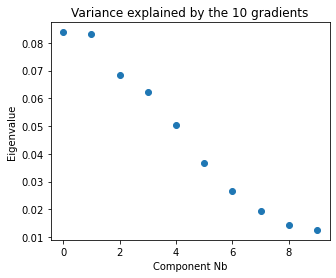

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.46

Scaled variance explained by individual gradients:
G1: 18.30%
G2: 18.14%
G3: 14.93%



In [89]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all females)
HCP_mean_ct_matrix_F = sum(HCP_ct_matrices_F)/len(HCP_ct_matrices_F)

# compute mean gradients
HCP_mean_ct_grad_F = compute_mean_gradients(mean_conn_matrix = HCP_mean_ct_matrix_F, display_output = True, data_reduction_algorithm = 'dm')

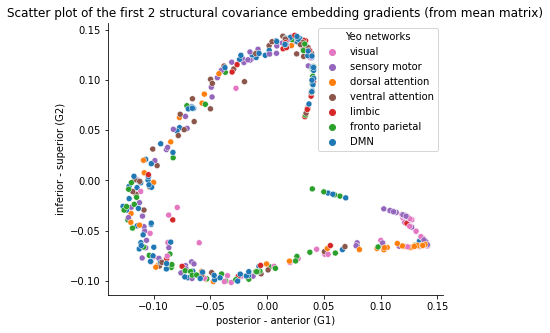

In [90]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=HCP_mean_ct_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=HCP_mean_ct_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

# Sex effects CT gradients (individual level) (standard linear regression - FDR-corrected)

In [91]:
# loading R results

# GSP model: linear model = Gradient_loadings ~ Sex + Age + Global CT 
GSP_R_lm_ct_G1_sex_contrast_res = pd.read_csv(resdir_gsp+'R_lm_ct_G1_sex_contrast_res.csv')  
GSP_R_lm_ct_G2_sex_contrast_res = pd.read_csv(resdir_gsp+'R_lm_ct_G2_sex_contrast_res.csv')  

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + Global CT + random effect family relatedness + random effect twin status + random effect (family relatedness * twin status) 
HCP_R_lmer_ct_G1_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_ct_G1_sex_contrast_res.csv')  
HCP_R_lmer_ct_G2_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_ct_G2_sex_contrast_res.csv')  


## Posterior - Anterior gradient (G1)

### GSP

Number of significant parcels: 97

Number of significant parcels for males: 52
Number of significant parcels for females: 45

Number of significant parcels in each Yeo network (across sexes):
- visual: 19 out of 61 (31.15%) -> 19.59% of overall significance
- sensory motor: 21 out of 77 (27.27%) -> 21.65% of overall significance
- DMN: 19 out of 90 (21.11%) -> 19.59% of overall significance
- dorsal attention: 4 out of 46 (8.7%) -> 4.12% of overall significance
- ventral attention: 12 out of 47 (25.53%) -> 12.37% of overall significance
- limbic: 9 out of 26 (34.62%) -> 9.28% of overall significance
- fronto parietal: 13 out of 53 (24.53%) -> 13.4% of overall significance





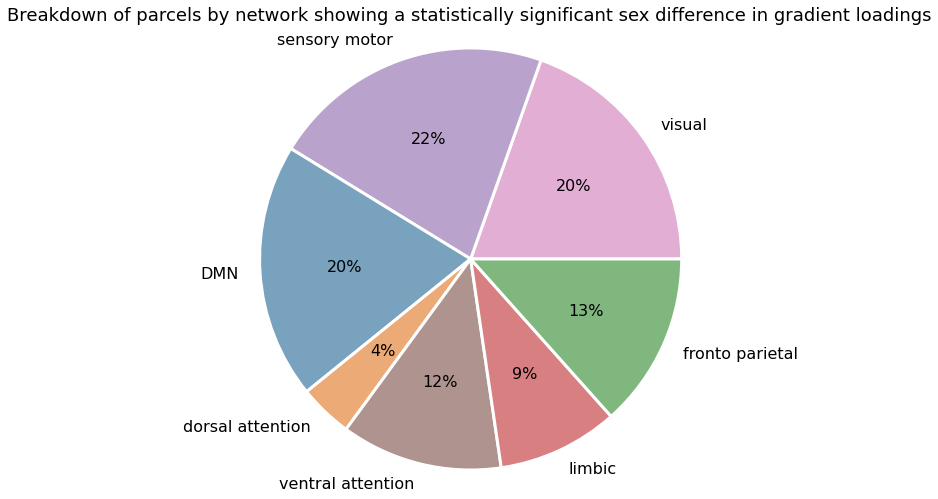

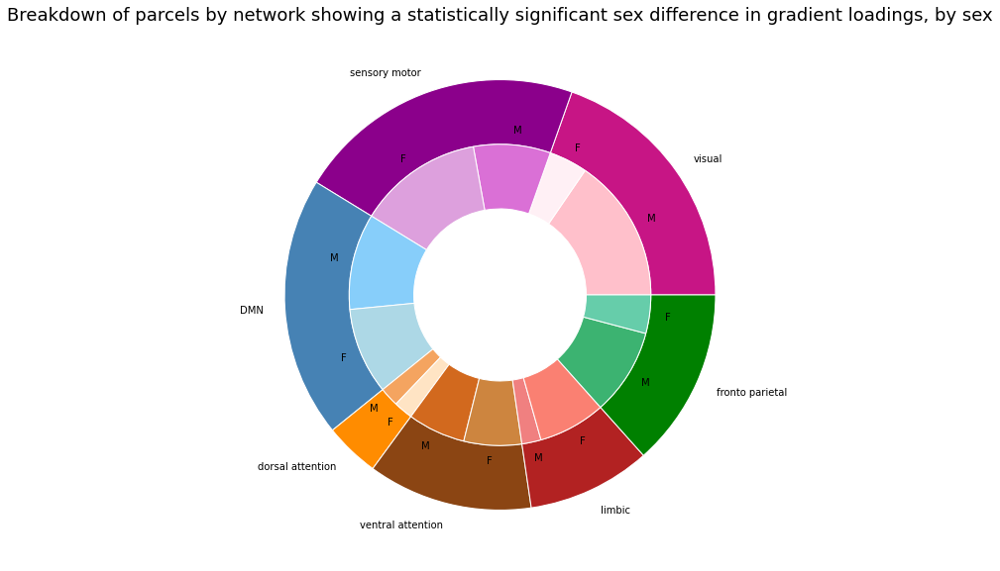

Number of significant parcels by sex:
visual - Male: 15, Female: 4
sensory motor - Male: 8, Female: 13
DMN - Male: 10, Female: 9
dorsal attention - Male: 2, Female: 2
ventral attention - Male: 6, Female: 6
limbic - Male: 2, Female: 7
fronto parietal - Male: 9, Female: 4



Violin plot of t-values (regression results) by Yeo network


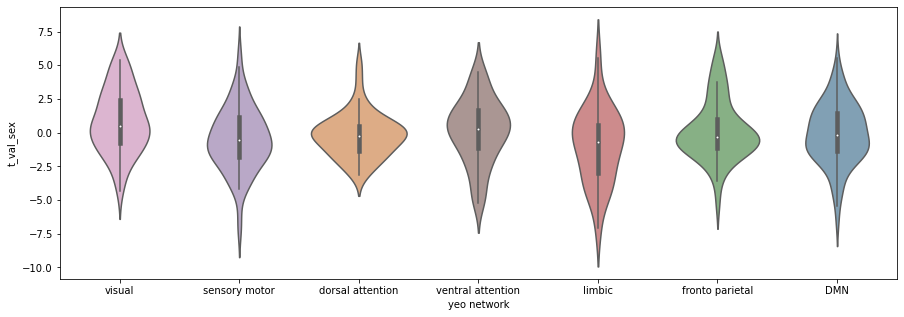

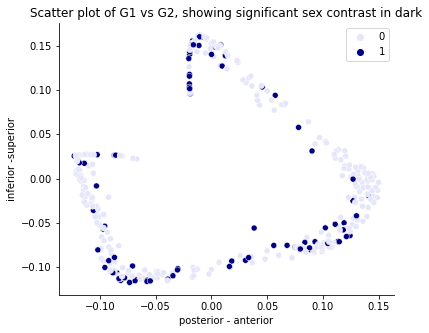

In [92]:
regression_contrast_results_breakdown_by_network(GSP_R_lm_ct_G1_sex_contrast_res, contrast_type = 'sex', 
                                                 scatter_x = GSP_mean_ct_grad.gradients_[:,0], scatter_y = GSP_mean_ct_grad.gradients_[:,1],
                                                scatter_x_label = 'posterior - anterior',  scatter_y_label = 'inferior -superior')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


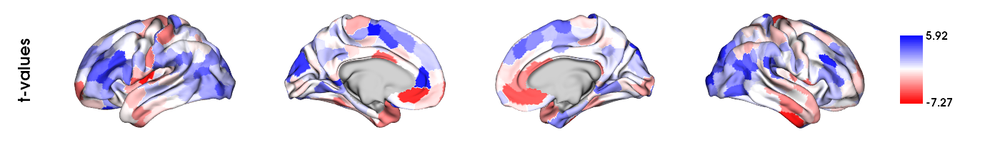

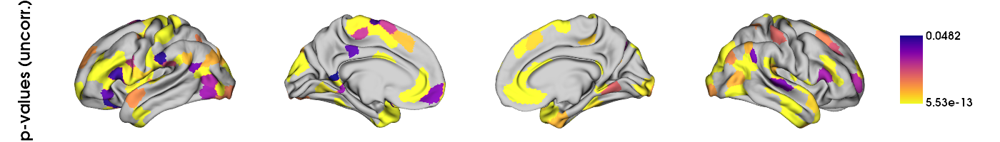

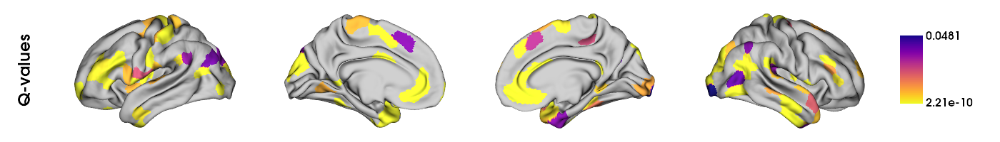

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

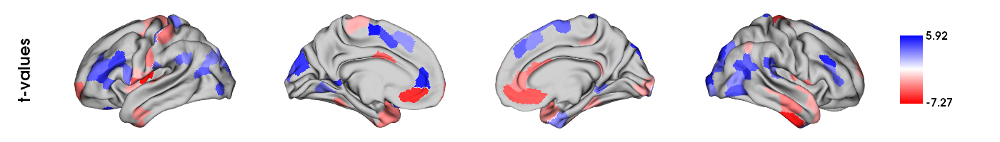

In [93]:
plots_to_display = plot_reg_results_R(GSP_R_lm_ct_G1_sex_contrast_res)
display(*plots_to_display)

### HCP

Number of significant parcels: 98

Number of significant parcels for males: 46
Number of significant parcels for females: 52

Number of significant parcels in each Yeo network (across sexes):
- visual: 17 out of 61 (27.87%) -> 17.35% of overall significance
- sensory motor: 17 out of 77 (22.08%) -> 17.35% of overall significance
- DMN: 19 out of 90 (21.11%) -> 19.39% of overall significance
- dorsal attention: 12 out of 46 (26.09%) -> 12.24% of overall significance
- ventral attention: 15 out of 47 (31.91%) -> 15.31% of overall significance
- limbic: 7 out of 26 (26.92%) -> 7.14% of overall significance
- fronto parietal: 11 out of 53 (20.75%) -> 11.22% of overall significance





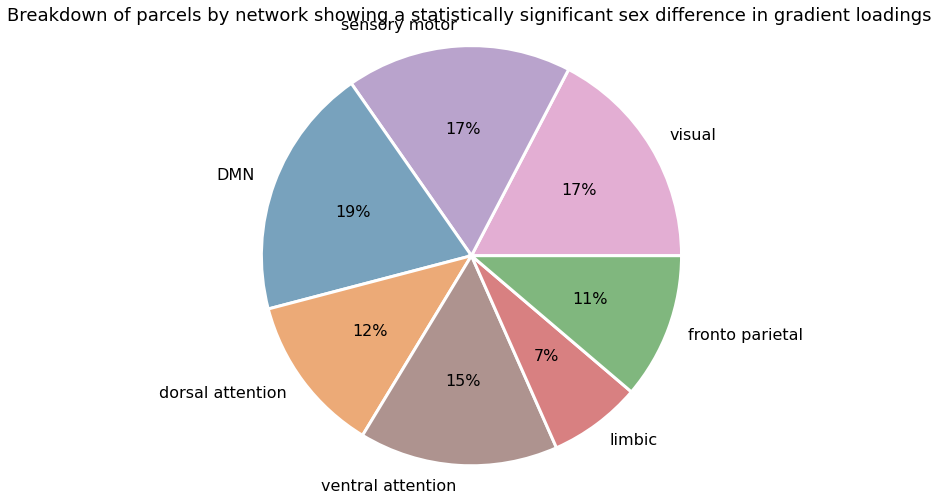

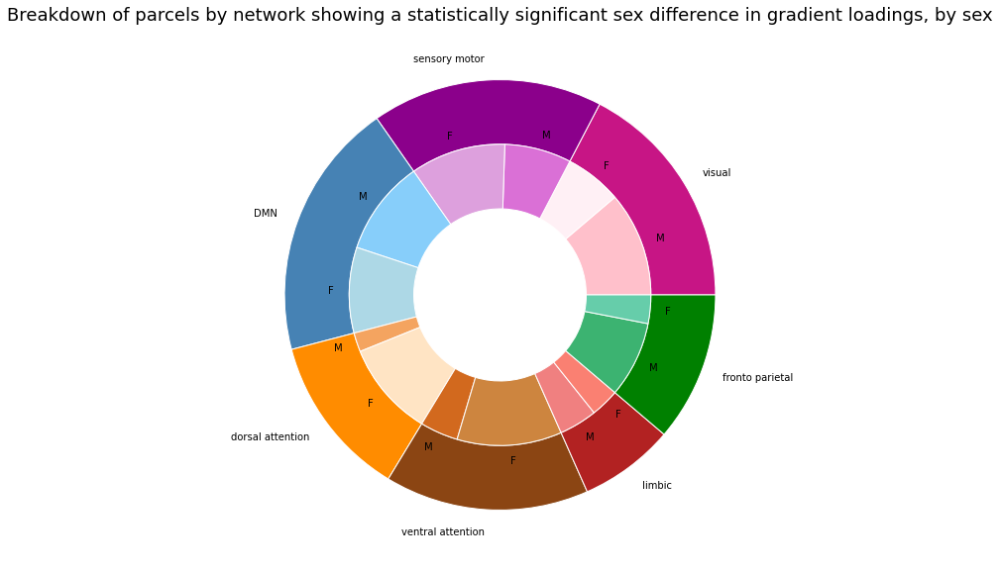

Number of significant parcels by sex:
visual - Male: 11, Female: 6
sensory motor - Male: 7, Female: 10
DMN - Male: 10, Female: 9
dorsal attention - Male: 2, Female: 10
ventral attention - Male: 4, Female: 11
limbic - Male: 4, Female: 3
fronto parietal - Male: 8, Female: 3



Violin plot of t-values (regression results) by Yeo network


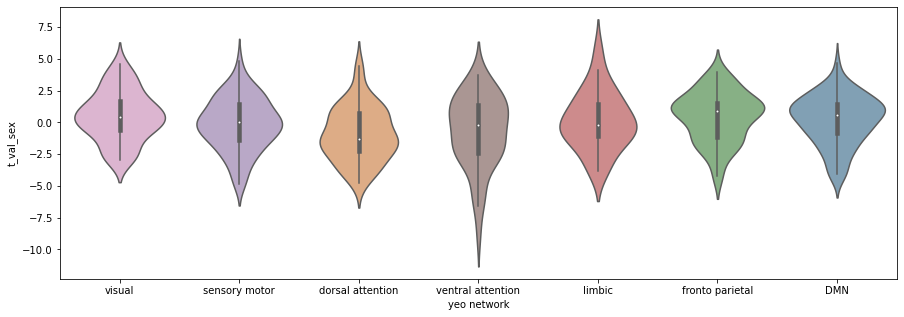

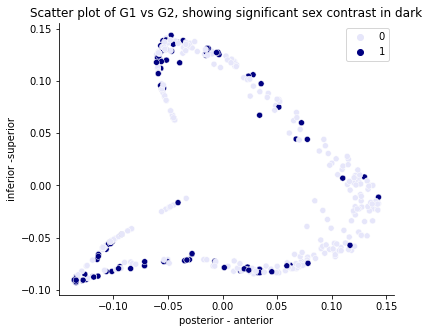

In [80]:
regression_contrast_results_breakdown_by_network(HCP_R_lmer_ct_G1_sex_contrast_res, contrast_type = 'sex', 
                                                 scatter_x = HCP_mean_ct_grad.gradients_[:,0], scatter_y = HCP_mean_ct_grad.gradients_[:,1],
                                                scatter_x_label = 'posterior - anterior',  scatter_y_label = 'inferior -superior')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


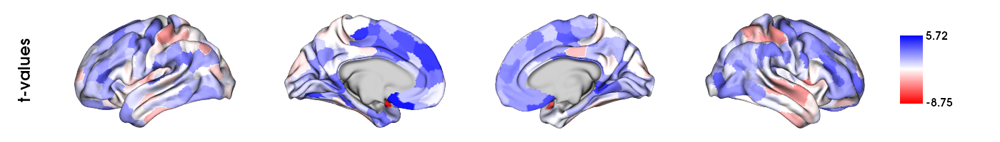

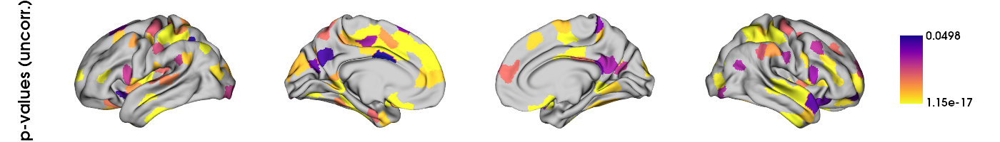

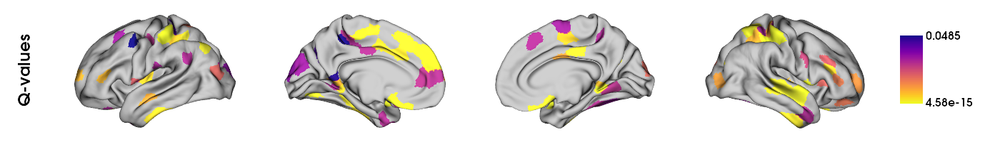

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

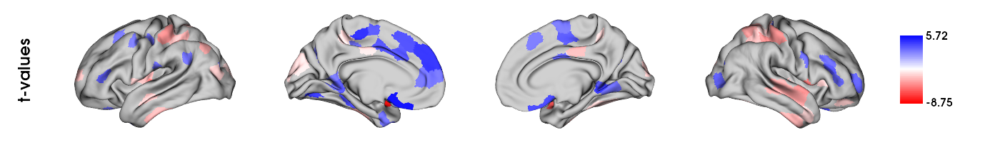

In [81]:
plots_to_display = plot_reg_results_R(HCP_R_lmer_ct_G1_sex_contrast_res)
display(*plots_to_display)

## Inferior - Superior gradient (G2)

### GSP

Number of significant parcels: 109

Number of significant parcels for males: 54
Number of significant parcels for females: 55

Number of significant parcels in each Yeo network (across sexes):
- visual: 16 out of 61 (26.23%) -> 14.68% of overall significance
- sensory motor: 18 out of 77 (23.38%) -> 16.51% of overall significance
- DMN: 26 out of 90 (28.89%) -> 23.85% of overall significance
- dorsal attention: 8 out of 46 (17.39%) -> 7.34% of overall significance
- ventral attention: 16 out of 47 (34.04%) -> 14.68% of overall significance
- limbic: 12 out of 26 (46.15%) -> 11.01% of overall significance
- fronto parietal: 13 out of 53 (24.53%) -> 11.93% of overall significance





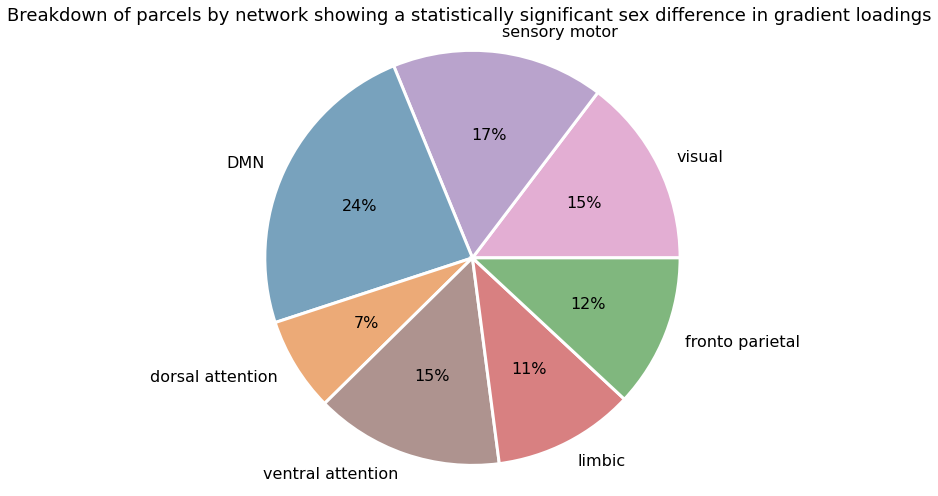

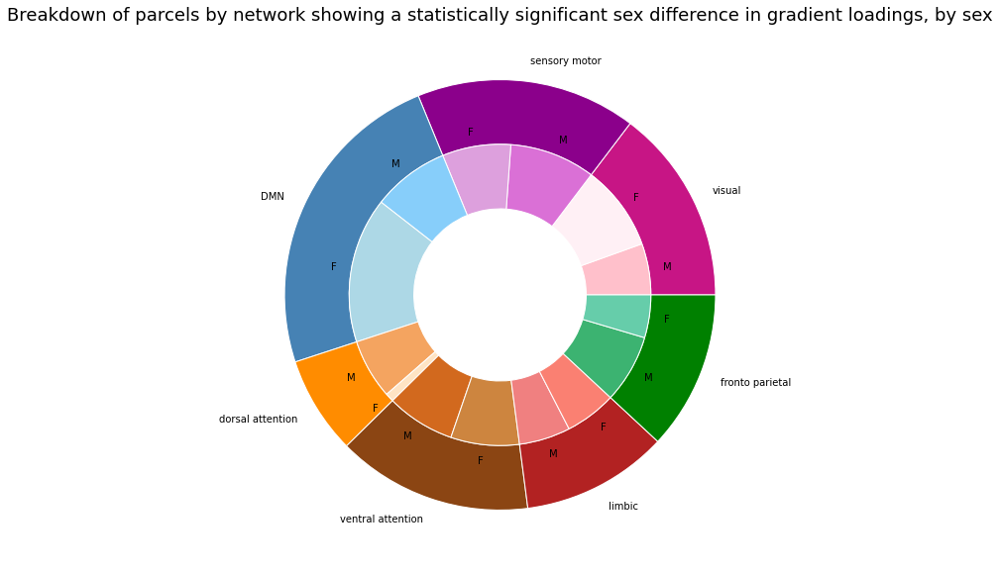

Number of significant parcels by sex:
visual - Male: 6, Female: 10
sensory motor - Male: 10, Female: 8
DMN - Male: 9, Female: 17
dorsal attention - Male: 7, Female: 1
ventral attention - Male: 8, Female: 8
limbic - Male: 6, Female: 6
fronto parietal - Male: 8, Female: 5



Violin plot of t-values (regression results) by Yeo network


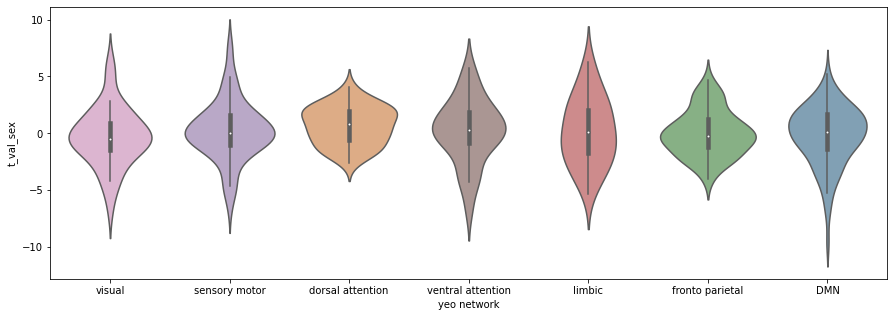

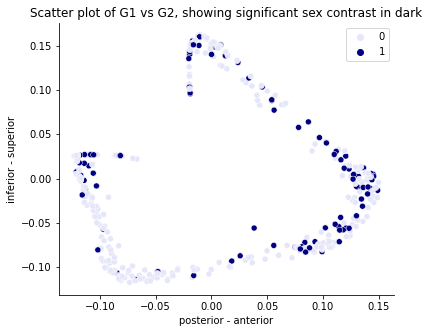

In [84]:
regression_contrast_results_breakdown_by_network(GSP_R_lm_ct_G2_sex_contrast_res, contrast_type = 'sex', 
                                                 scatter_x = GSP_mean_ct_grad.gradients_[:,0], scatter_y = GSP_mean_ct_grad.gradients_[:,1],
                                                scatter_x_label = 'posterior - anterior',  scatter_y_label = 'inferior - superior')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


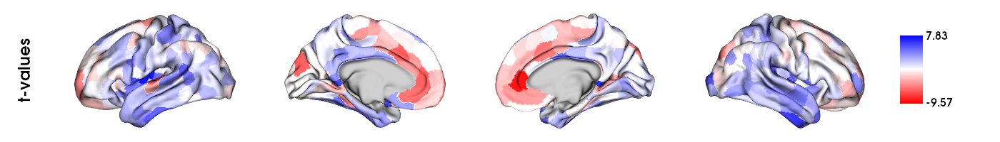

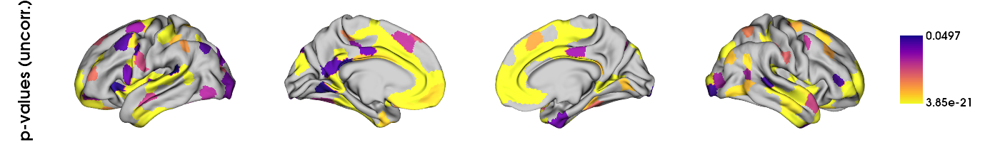

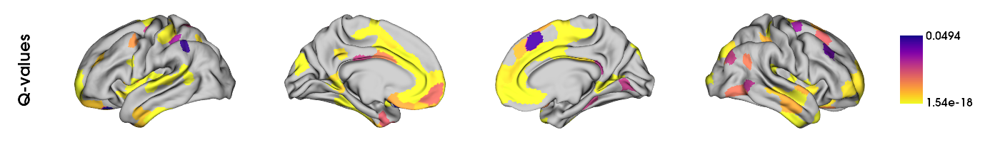

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

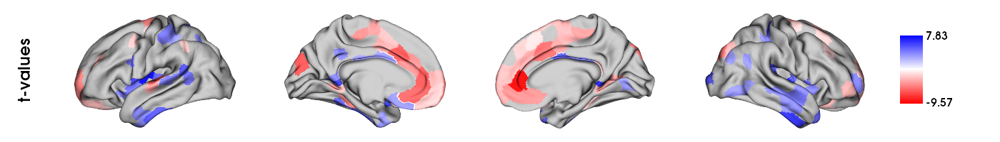

In [85]:
plots_to_display = plot_reg_results_R(GSP_R_lm_ct_G2_sex_contrast_res)
display(*plots_to_display)

### HCP

Number of significant parcels: 83

Number of significant parcels for males: 44
Number of significant parcels for females: 39

Number of significant parcels in each Yeo network (across sexes):
- visual: 10 out of 61 (16.39%) -> 12.05% of overall significance
- sensory motor: 17 out of 77 (22.08%) -> 20.48% of overall significance
- DMN: 20 out of 90 (22.22%) -> 24.1% of overall significance
- dorsal attention: 5 out of 46 (10.87%) -> 6.02% of overall significance
- ventral attention: 13 out of 47 (27.66%) -> 15.66% of overall significance
- limbic: 6 out of 26 (23.08%) -> 7.23% of overall significance
- fronto parietal: 12 out of 53 (22.64%) -> 14.46% of overall significance





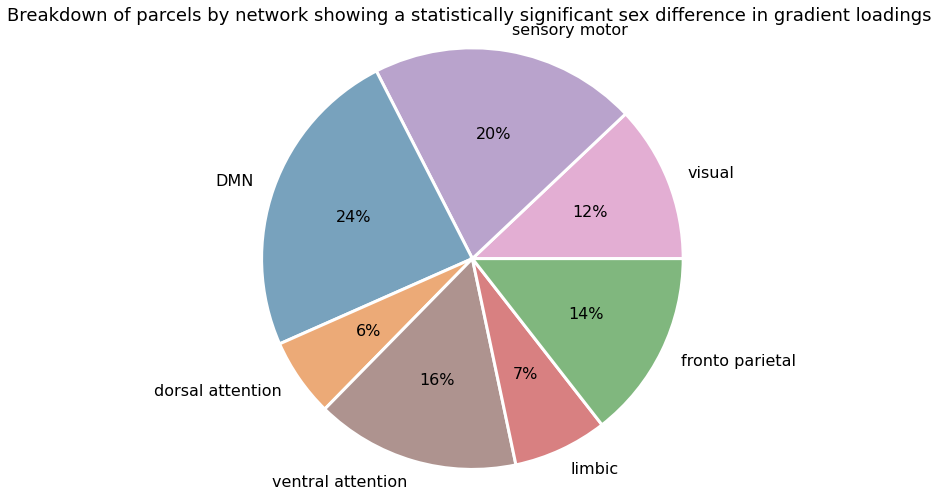

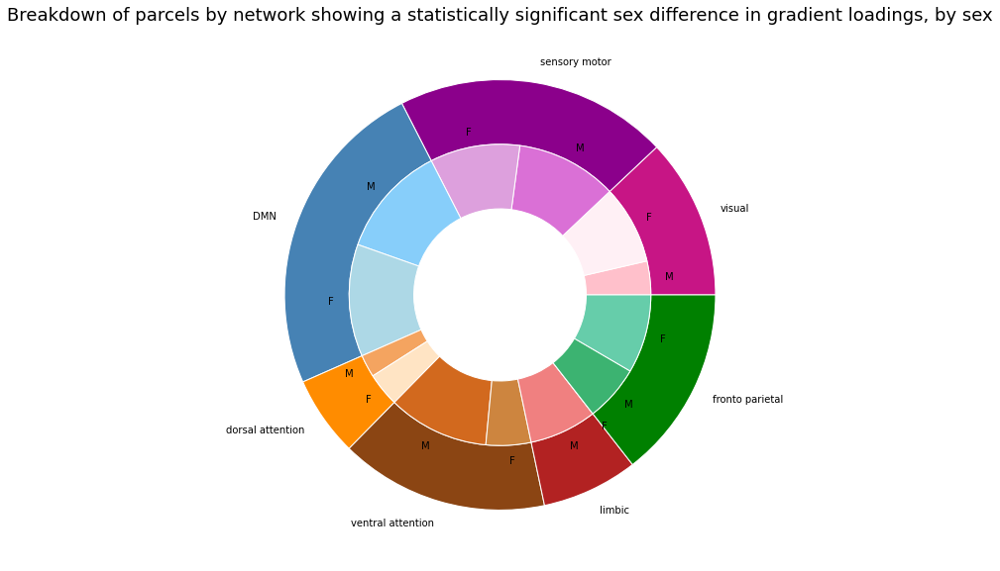

Number of significant parcels by sex:
visual - Male: 3, Female: 7
sensory motor - Male: 9, Female: 8
DMN - Male: 10, Female: 10
dorsal attention - Male: 2, Female: 3
ventral attention - Male: 9, Female: 4
limbic - Male: 6, Female: 0
fronto parietal - Male: 5, Female: 7



Violin plot of t-values (regression results) by Yeo network


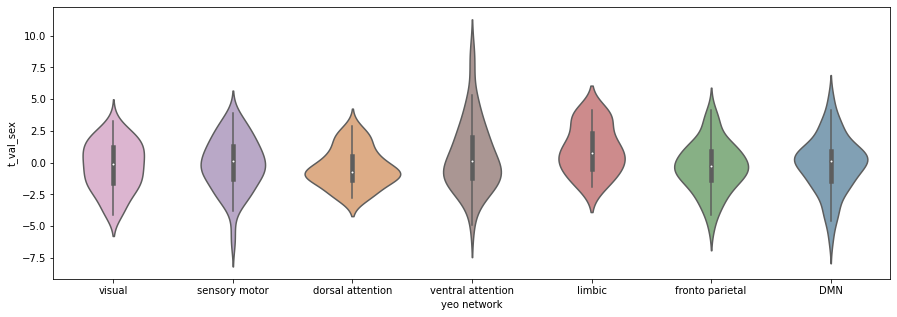

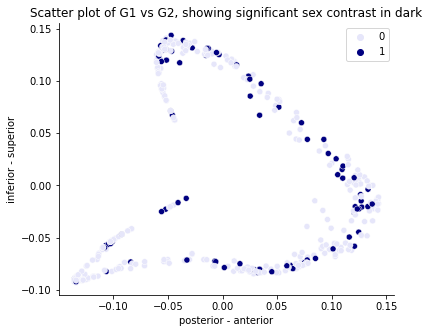

In [87]:
regression_contrast_results_breakdown_by_network(HCP_R_lmer_ct_G2_sex_contrast_res, contrast_type = 'sex', 
                                                 scatter_x = HCP_mean_ct_grad.gradients_[:,0], scatter_y = HCP_mean_ct_grad.gradients_[:,1], 
                                                 scatter_x_label = 'posterior - anterior',  scatter_y_label = 'inferior - superior')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


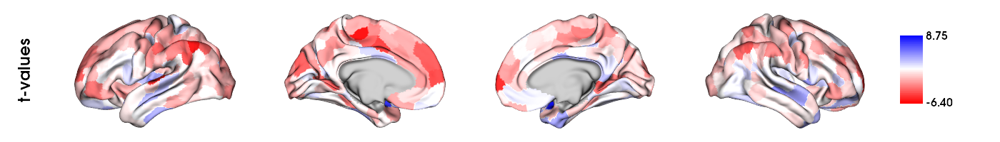

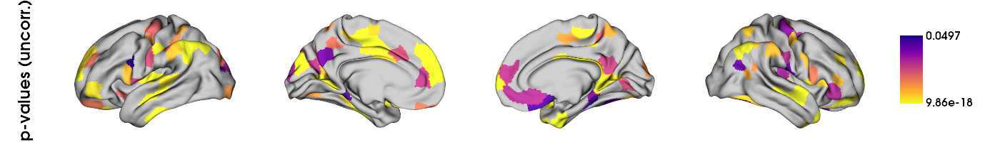

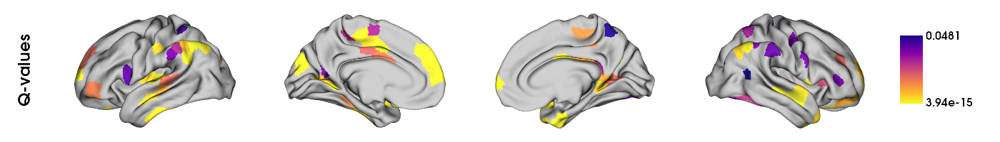

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

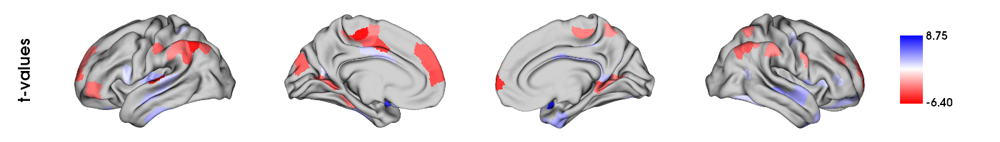

In [88]:
plots_to_display = plot_reg_results_R(HCP_R_lmer_ct_G2_sex_contrast_res)
display(*plots_to_display)

# Structural covariance (CT) - i.e., group level
Studied across subjects

## Structural covariance (CT) matrix (one matrix across subjects)

Computed using partial correlations

### GSP

#### Covariates included in the partial correlations:
- age, global CT, sex (all subjects)
- age, global CT (by sex)

#### **!! ATTENTION !!** Matrix calculation takes about 30min to run (13min for GSP_mean_ct_cov_matrix.csv + probably 13min for males and females separately) 
Therefore commented out the actual matrix calculation and exportation -> importing the salved matrices instead

#### Export CT structural covariance matrices as csv files given that they take so long to compute

#### Load CT structrual covariance matrices

In [59]:
# all subjects
GSP_mean_ct_cov_matrix = pd.read_csv(datadir+'ct_matrices/GSP/GSP_mean_ct_cov_matrix.csv', header = None).to_numpy()

# males
GSP_mean_ct_cov_matrix_M = pd.read_csv(datadir+'ct_matrices/GSP/GSP_mean_ct_cov_matrix_M.csv', header = None).to_numpy()

# females
GSP_mean_ct_cov_matrix_F = pd.read_csv(datadir+'ct_matrices/GSP/GSP_mean_ct_cov_matrix_F.csv', header = None).to_numpy()

### HCP

#### Covariates included in the partial correlations:
- global CT, age, family ID, twin status, sex (all subjects)
- global CT, age, family ID, twin status (by sex)

#### **!! ATTENTION !!** Matrix calculation takes about 30min to run 
Therefore commented out the actual matrix calculation and exportation -> importing the salved matrices instead

#### Export CT structural covariance matrices as csv files given that they take so long to compute

#### Load CT structrual covariance matrices

In [58]:
# all subjects
HCP_mean_ct_cov_matrix = pd.read_csv(datadir+'ct_matrices/HCP/HCP_mean_ct_cov_matrix.csv', header = None).to_numpy()

# males
HCP_mean_ct_cov_matrix_M = pd.read_csv(datadir+'ct_matrices/HCP/HCP_mean_ct_cov_matrix_M.csv', header = None).to_numpy()

# females
HCP_mean_ct_cov_matrix_F = pd.read_csv(datadir+'ct_matrices/HCP/HCP_mean_ct_cov_matrix_F.csv', header = None).to_numpy()

## Structural covariance (CT) gradients (one set of gradients across subjects)
The equivalent of a mean gradients (given that there is only 1 set of them representing the data of all subjects)

### All subjects (across sexes)

#### GSP

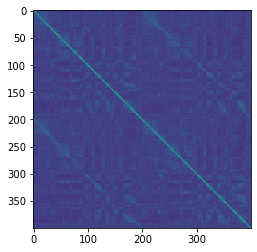

(400, 400)


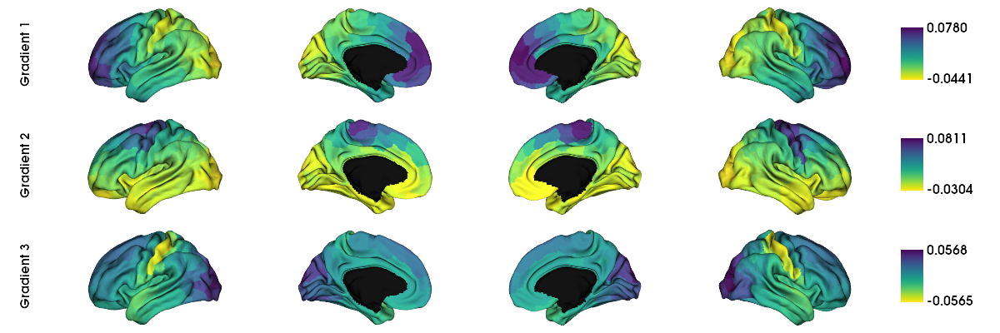

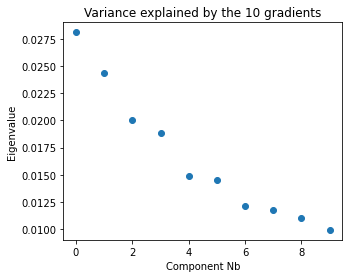

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.17

Scaled variance explained by individual gradients:
G1: 16.97%
G2: 14.72%
G3: 12.09%



In [61]:
GSP_ct_cov_grad = compute_mean_gradients(mean_conn_matrix = GSP_mean_ct_cov_matrix, display_output = True, data_reduction_algorithm = 'dm')

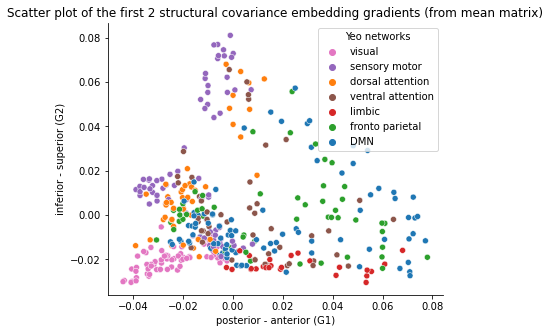

In [62]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=GSP_ct_cov_grad.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=GSP_ct_cov_grad.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

#### HCP

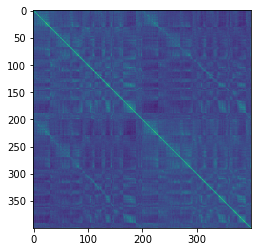

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


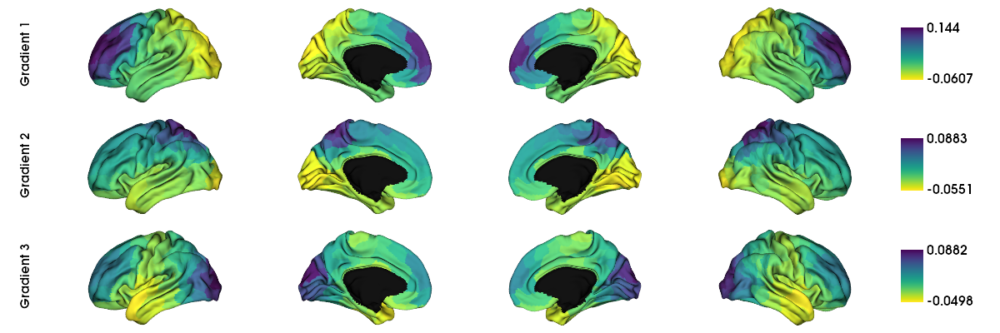

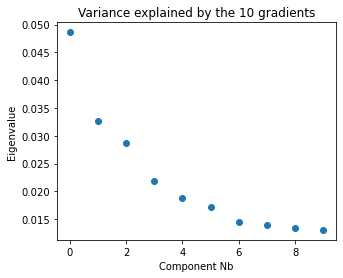

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.22

Scaled variance explained by individual gradients:
G1: 21.81%
G2: 14.67%
G3: 12.87%



In [63]:
HCP_ct_cov_grad = compute_mean_gradients(mean_conn_matrix = HCP_mean_ct_cov_matrix, display_output = True, data_reduction_algorithm = 'dm')

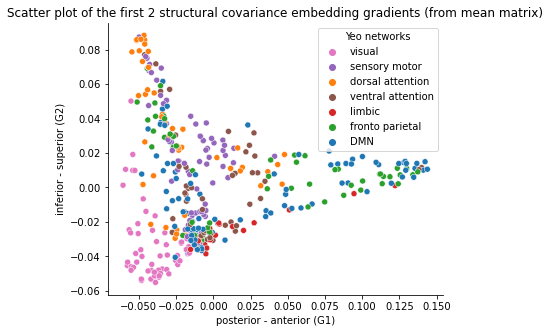

In [64]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=HCP_ct_cov_grad.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=HCP_ct_cov_grad.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

### By sex

#### GSP

##### Males

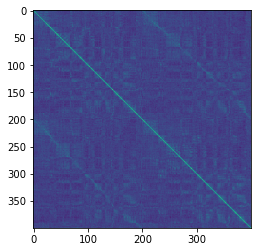

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


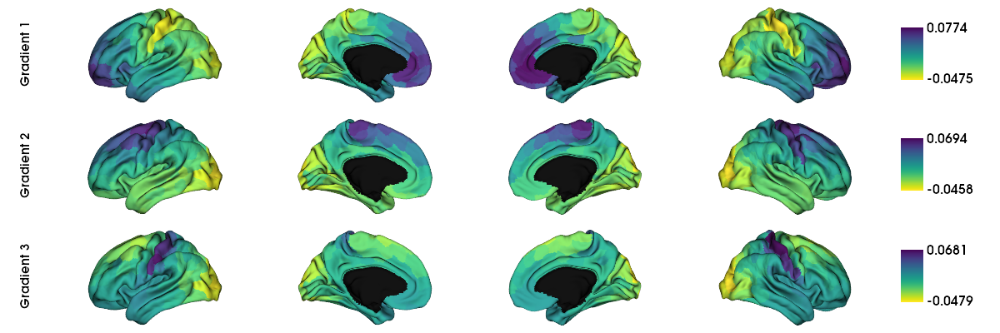

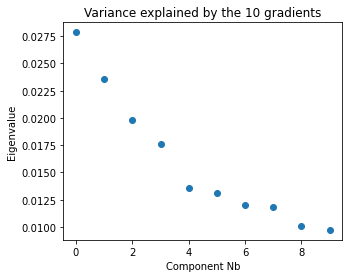

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.16

Scaled variance explained by individual gradients:
G1: 17.49%
G2: 14.81%
G3: 12.45%



In [65]:
GSP_ct_cov_grad_M = compute_mean_gradients(mean_conn_matrix = GSP_mean_ct_cov_matrix_M, display_output = True, data_reduction_algorithm = 'dm')

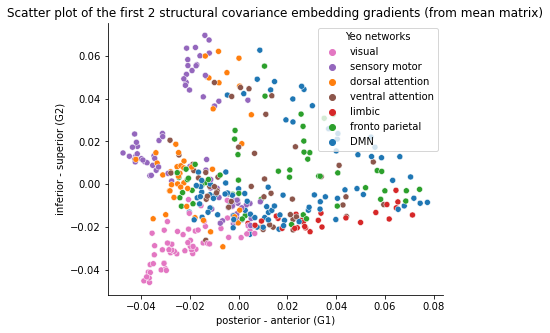

In [66]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=GSP_ct_cov_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=GSP_ct_cov_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

##### Females

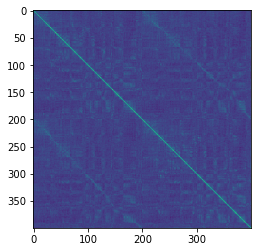

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


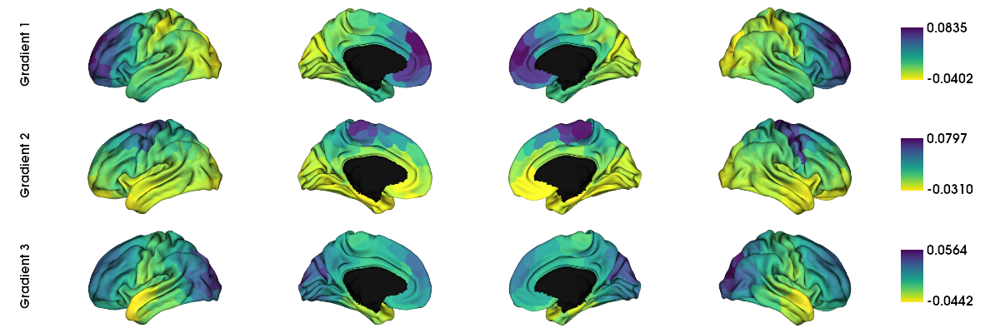

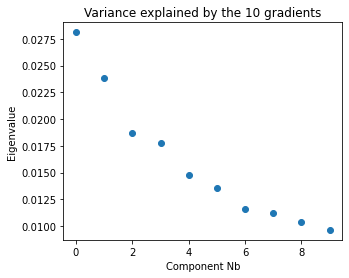

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.16

Scaled variance explained by individual gradients:
G1: 17.60%
G2: 14.95%
G3: 11.71%



In [67]:
GSP_ct_cov_grad_F = compute_mean_gradients(mean_conn_matrix = GSP_mean_ct_cov_matrix_F, display_output = True, data_reduction_algorithm = 'dm')

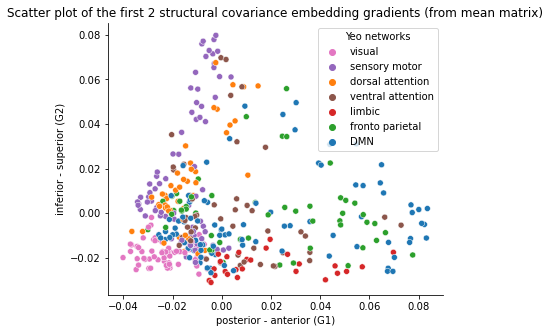

In [68]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=GSP_ct_cov_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=GSP_ct_cov_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

#### HCP

##### Males

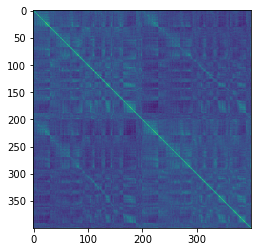

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


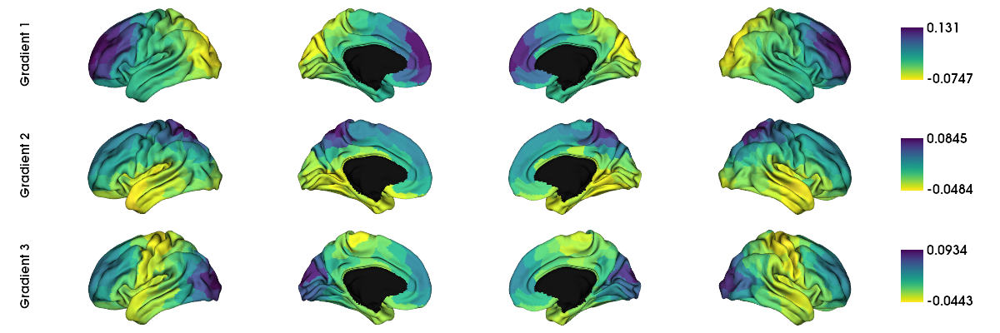

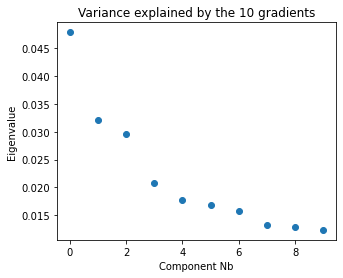

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.22

Scaled variance explained by individual gradients:
G1: 21.82%
G2: 14.66%
G3: 13.46%



In [69]:
HCP_ct_cov_grad_M = compute_mean_gradients(mean_conn_matrix = HCP_mean_ct_cov_matrix_M, display_output = True, data_reduction_algorithm = 'dm')

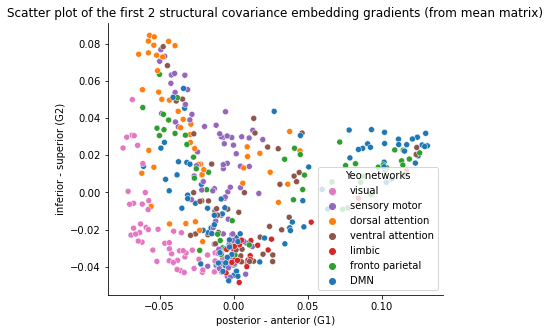

In [70]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=HCP_ct_cov_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=HCP_ct_cov_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

##### Females

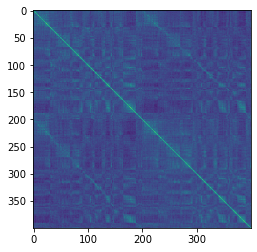

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


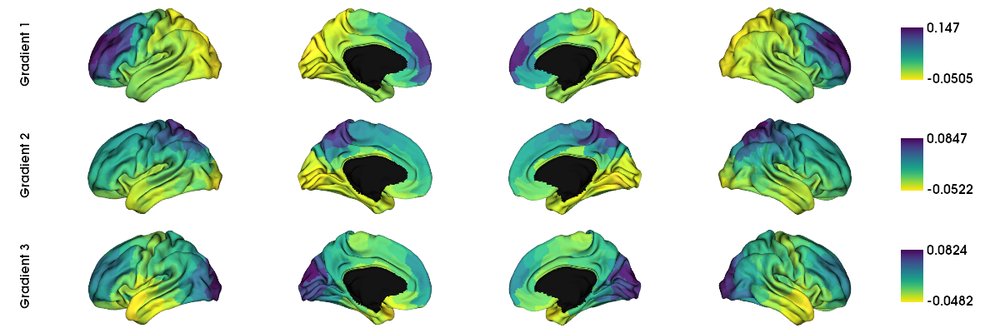

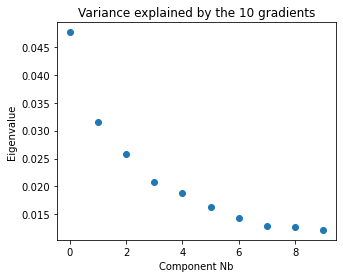

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.21

Scaled variance explained by individual gradients:
G1: 22.36%
G2: 14.84%
G3: 12.11%



In [71]:
HCP_ct_cov_grad_F = compute_mean_gradients(mean_conn_matrix = HCP_mean_ct_cov_matrix_F, display_output = True, data_reduction_algorithm = 'dm')

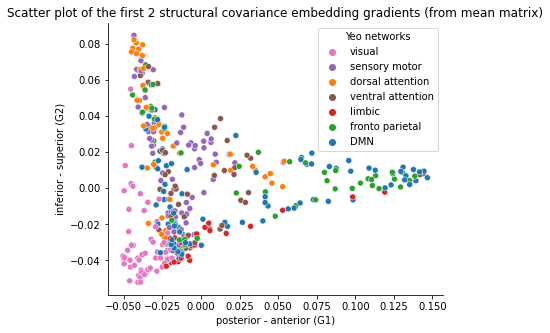

In [72]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=HCP_ct_cov_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1: posterior - anterior)
                     y=HCP_ct_cov_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2: inferior - superior)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('posterior - anterior (G1)');
ax.set_ylabel('inferior - superior (G2)');
ax.set_title("Scatter plot of the first 2 structural covariance embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

# Comparing structural (CT) results between GSP and HCP samples

## Structural covariance (CT) gradients (group level)

### Correlation of covariance CT gradients

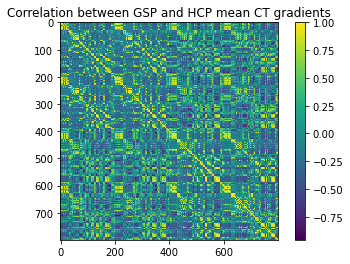

(800, 800)


In [94]:
GSP_HCP_ct_loadings_corr = np.corrcoef(np.array(GSP_ct_cov_grad.gradients_), np.array(HCP_ct_cov_grad.gradients_))

# data
fig, ax = plt.subplots()
heatmap = ax.pcolor(GSP_HCP_ct_loadings_corr)
# legend
cbar = plt.colorbar(heatmap)
plt.imshow(np.corrcoef(GSP_HCP_ct_loadings_corr))
plt.title('Correlation between GSP and HCP mean CT gradients', fontdict=None, loc='center', pad=None)
plt.show()
print(GSP_HCP_ct_loadings_corr.shape)

### Anterior-Posterior (G1)

Overall Pearson correlation between GSP across sexes anterior-posterior (G1)  and HCP across sexes anterior-posterior (G1): r = 0.89; p = 0.0

visual: r = 0.95, p = 0.0
sensory motor: r = 0.76, p = 0.0
dorsal attention: r = 0.83, p = 0.0
ventral attention: r = 0.77, p = 0.0
limbic: r = 0.79, p = 0.0
fronto parietal: r = 0.9, p = 0.0
DMN: r = 0.93, p = 0.0




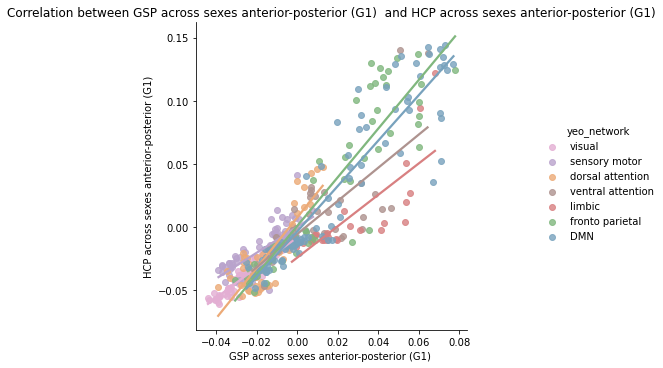

In [95]:
print_plot_corr_networks(x = GSP_ct_cov_grad.gradients_[:,0], y = HCP_ct_cov_grad.gradients_[:,0], x_label = 'GSP across sexes anterior-posterior (G1) ', y_label = 'HCP across sexes anterior-posterior (G1)')

Spin permutation test (correlation of gradient loadings)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.002


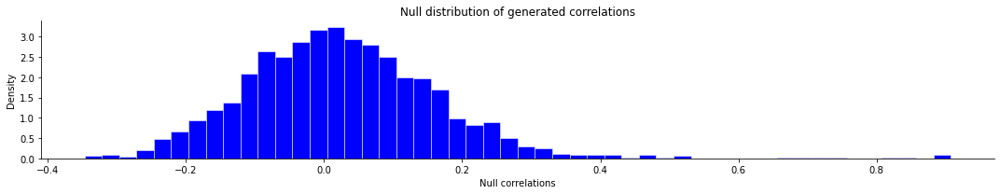

In [96]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_ct_cov_grad.gradients_[:,0], y = HCP_ct_cov_grad.gradients_[:,0])

Visualizing gradients by network

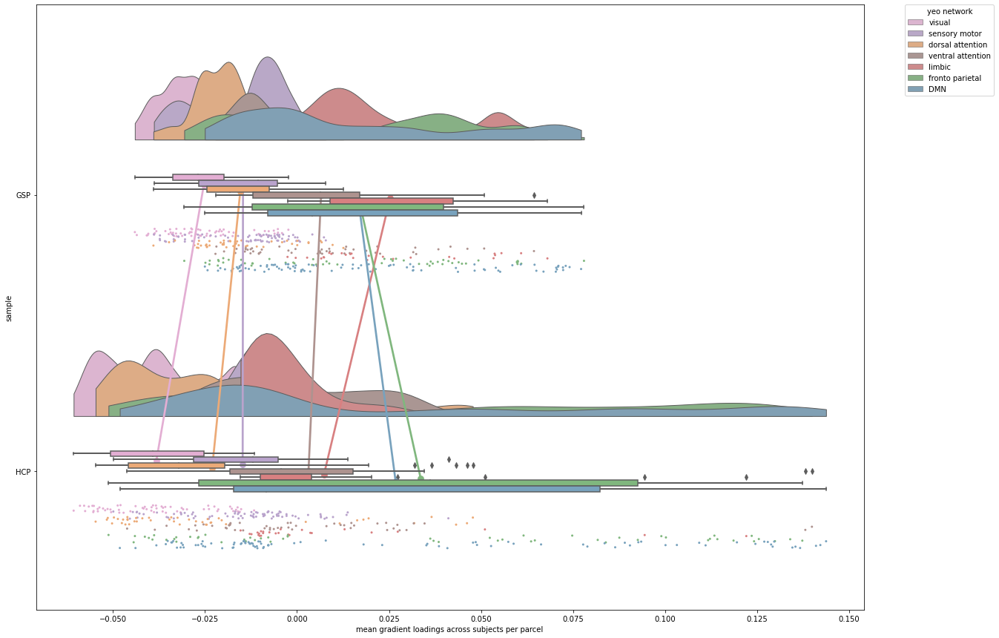

In [97]:
RainCloudPlot_YeoNetworks_SampleComparison_Grad(array_grad_sample_1 = GSP_ct_cov_grad.gradients_[:,0], array_grad_sample_2 = HCP_ct_cov_grad.gradients_[:,0], sample_1_label = "GSP", sample_2_label = "HCP")

### Inferior-Superior (G2)

Overall Pearson correlation between GSP across sexes inferior-superior (G2)  and HCP across sexes inferior-superior (G2): r = 0.6; p = 0.0

visual: r = 0.35, p = 0.005
sensory motor: r = 0.5, p = 0.0
dorsal attention: r = 0.09, p = 0.546
ventral attention: r = 0.69, p = 0.0
limbic: r = 0.13, p = 0.514
fronto parietal: r = 0.41, p = 0.002
DMN: r = 0.63, p = 0.0




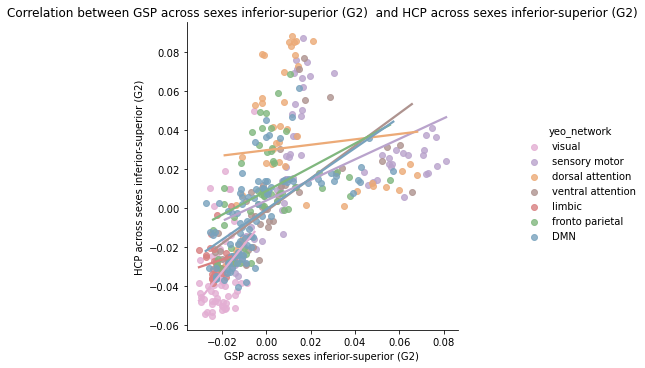

In [98]:
print_plot_corr_networks(x = GSP_ct_cov_grad.gradients_[:,1], y = HCP_ct_cov_grad.gradients_[:,1], x_label = 'GSP across sexes inferior-superior (G2) ', y_label = 'HCP across sexes inferior-superior (G2)')

Spin permutation test (correlation of gradient loadings)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


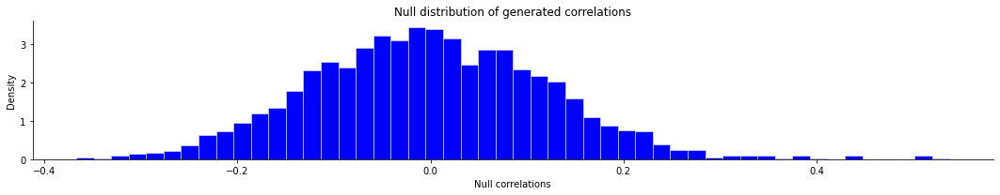

In [99]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_ct_cov_grad.gradients_[:,1], y = HCP_ct_cov_grad.gradients_[:,1])

Visualizing gradients by network

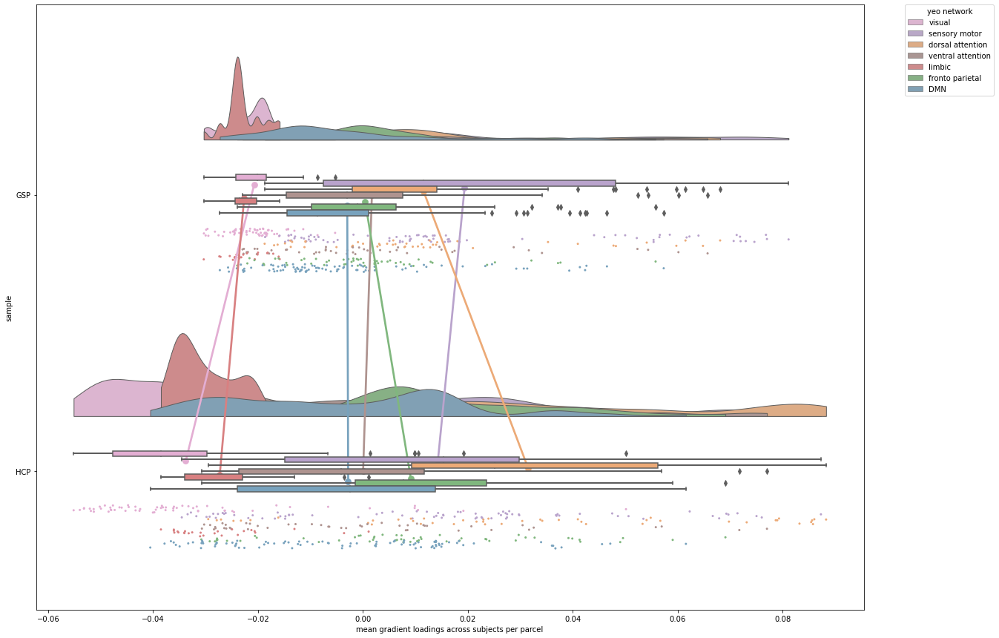

In [100]:
RainCloudPlot_YeoNetworks_SampleComparison_Grad(array_grad_sample_1 = GSP_ct_cov_grad.gradients_[:,1], array_grad_sample_2 = HCP_ct_cov_grad.gradients_[:,1], sample_1_label = "GSP", sample_2_label = "HCP")

## Structural (CT) gradients (individual level)

### Correlation of covariance CT gradients

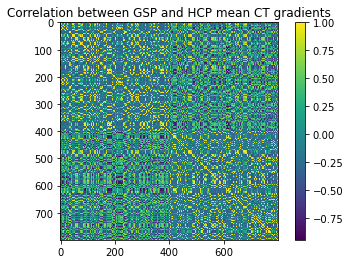

(800, 800)


In [101]:
GSP_HCP_ct_loadings_corr = np.corrcoef(np.array(GSP_mean_ct_grad.gradients_), np.array(HCP_mean_ct_grad.gradients_))

# data
fig, ax = plt.subplots()
heatmap = ax.pcolor(GSP_HCP_ct_loadings_corr)
# legend
cbar = plt.colorbar(heatmap)
plt.imshow(np.corrcoef(GSP_HCP_ct_loadings_corr))
plt.title('Correlation between GSP and HCP mean CT gradients', fontdict=None, loc='center', pad=None)
plt.show()
print(GSP_HCP_ct_loadings_corr.shape)

### Anterior-Posterior (G1)

Overall Pearson correlation between GSP across sexes anterior-posterior (G1)  and HCP across sexes anterior-posterior (G1): r = 0.6; p = 0.0

visual: r = 0.64, p = 0.0
sensory motor: r = 0.74, p = 0.0
dorsal attention: r = 0.81, p = 0.0
ventral attention: r = 0.31, p = 0.037
limbic: r = 0.09, p = 0.667
fronto parietal: r = 0.46, p = 0.0
DMN: r = 0.4, p = 0.0




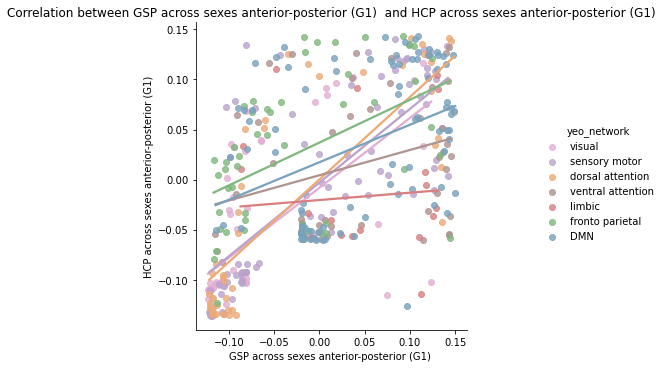

In [102]:
print_plot_corr_networks(x = GSP_mean_ct_grad.gradients_[:,0], y = HCP_mean_ct_grad.gradients_[:,0], x_label = 'GSP across sexes anterior-posterior (G1) ', y_label = 'HCP across sexes anterior-posterior (G1)')

Spin permutation test (correlation of gradient loadings)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.002


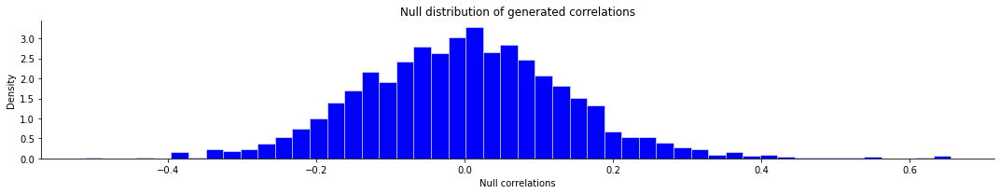

In [103]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_mean_ct_grad.gradients_[:,0], y = HCP_mean_ct_grad.gradients_[:,0])

Visualizing gradients by network

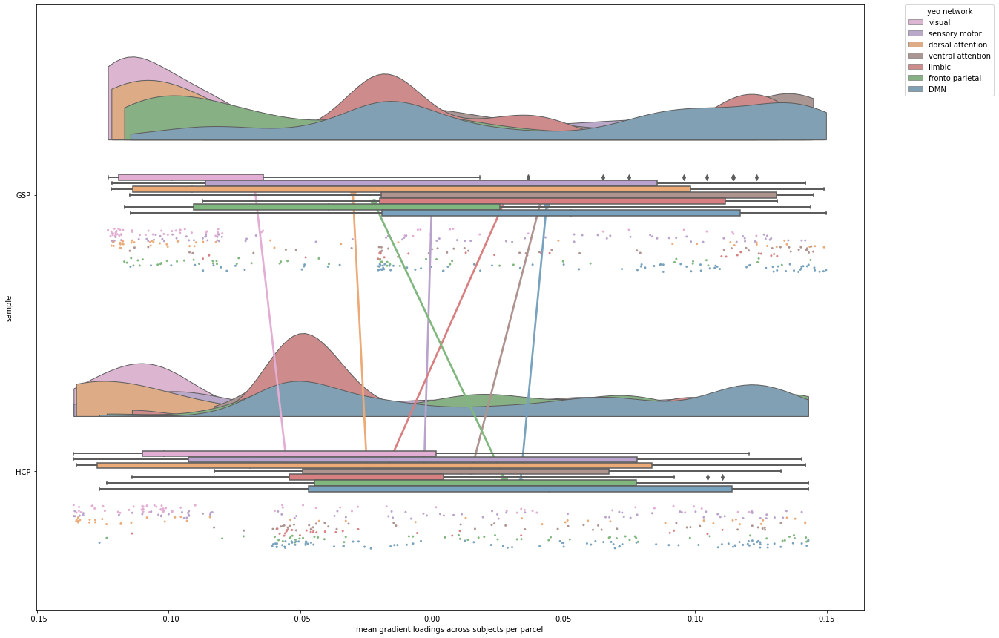

In [104]:
RainCloudPlot_YeoNetworks_SampleComparison_Grad(array_grad_sample_1 = GSP_mean_ct_grad.gradients_[:,0], array_grad_sample_2 = HCP_mean_ct_grad.gradients_[:,0], sample_1_label = "GSP", sample_2_label = "HCP")

### Inferior-Superior (G2)

Overall Pearson correlation between GSP across sexes inferior-superior (G2)  and HCP across sexes inferior-superior (G2): r = 0.67; p = 0.0

visual: r = 0.5, p = 0.0
sensory motor: r = 0.6, p = 0.0
dorsal attention: r = 0.06, p = 0.678
ventral attention: r = 0.68, p = 0.0
limbic: r = 0.66, p = 0.0
fronto parietal: r = 0.8, p = 0.0
DMN: r = 0.8, p = 0.0




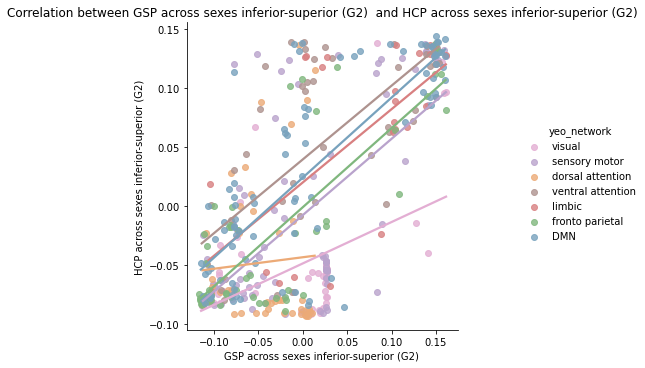

In [105]:
print_plot_corr_networks(x = GSP_mean_ct_grad.gradients_[:,1], y = HCP_mean_ct_grad.gradients_[:,1], x_label = 'GSP across sexes inferior-superior (G2) ', y_label = 'HCP across sexes inferior-superior (G2)')

Spin permutation test (correlation of gradient loadings)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.002


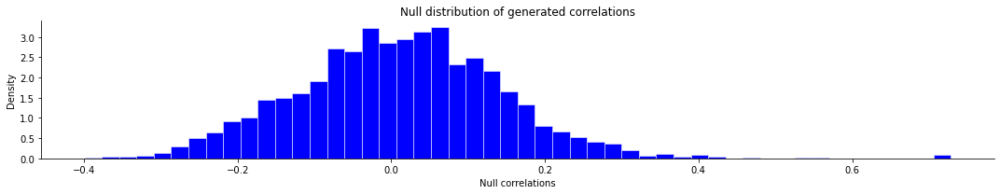

In [106]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_mean_ct_grad.gradients_[:,1], y = HCP_mean_ct_grad.gradients_[:,1])

Visualizing gradients by network

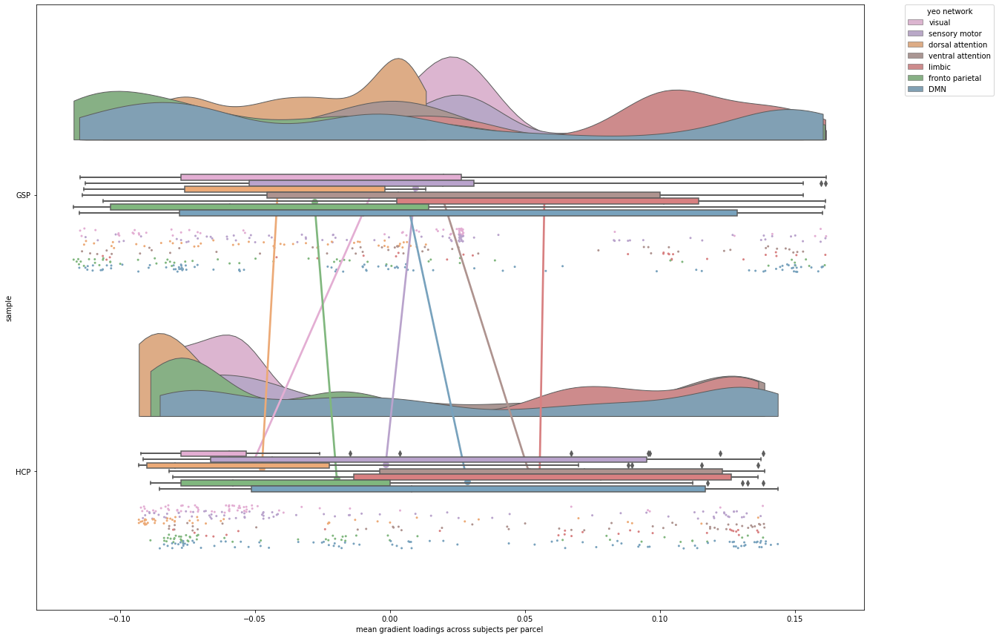

In [107]:
RainCloudPlot_YeoNetworks_SampleComparison_Grad(array_grad_sample_1 = GSP_mean_ct_grad.gradients_[:,1], array_grad_sample_2 = HCP_mean_ct_grad.gradients_[:,1], sample_1_label = "GSP", sample_2_label = "HCP")

## Sex differences (individual CT gradients)

### G1

#### Correlation t-values

Overall Pearson correlation between GSP sex contrast G1 CT t-values and HCP sex contrast G1 CT t-values: r = 0.33; p = 0.0

visual: r = 0.08, p = 0.55
sensory motor: r = 0.35, p = 0.002
dorsal attention: r = 0.25, p = 0.089
ventral attention: r = 0.63, p = 0.0
limbic: r = 0.22, p = 0.278
fronto parietal: r = 0.45, p = 0.001
DMN: r = 0.25, p = 0.019




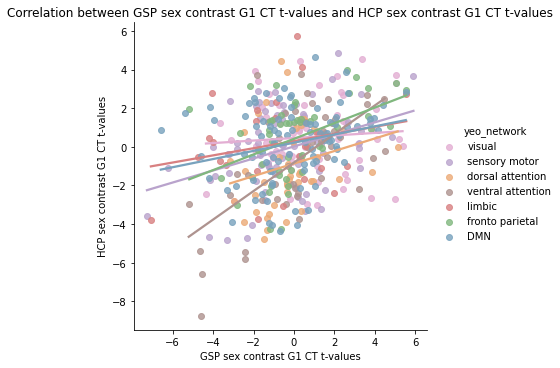

In [108]:
print_plot_corr_networks(x = GSP_R_lm_ct_G1_sex_contrast_res.t_val_sex, y = HCP_R_lmer_ct_G1_sex_contrast_res.t_val_sex, x_label = 'GSP sex contrast G1 CT t-values', y_label = 'HCP sex contrast G1 CT t-values')

#### Spin permutation test (for correlation of t-values)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0125


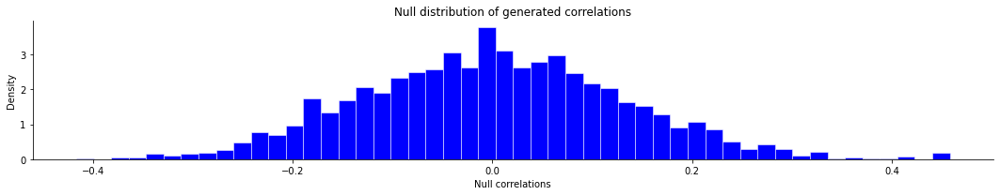

In [109]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_R_lm_ct_G1_sex_contrast_res.t_val_sex, y = HCP_R_lmer_ct_G1_sex_contrast_res.t_val_sex)

### Comparing parcels showing statistically significant sex differences between datasets

Number of parcels that show statistically significant sex differences across datasets: 31
Number of parcels that show statistically significant sex differences in GSP G1 CT only: 66
Number of parcels that show statistically significant sex differences in HCP G1 CT only: 67
Number of parcels (out of the 31 parcels that show sig sex differences in both datasets) which show sex differences in opposite directions: 3



'Overlap of significant sex differences: 2 (dark green): significant in both samples, 1 (light green): significant in one sample, 0: not significant'

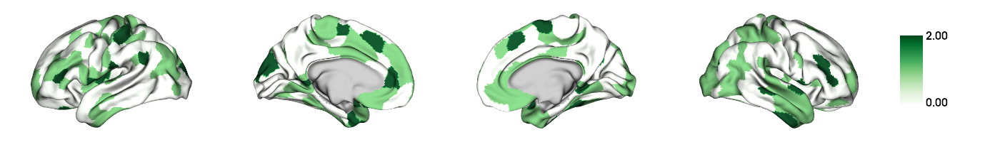

'Which dataset shows significant sex difference: +1 (purple) GSP G1 CT, -1 (brown) = HCP G1 CT, 0 (white) = both datasets, nan (grey) = not significant in any dataset'

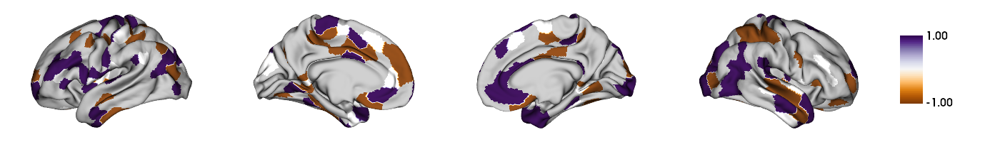

'Parcels showing sex differences in opposite directions'

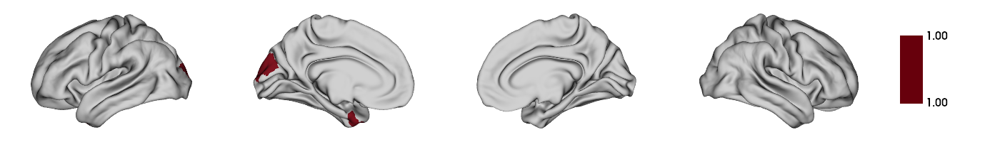

In [110]:
plots_to_display = plot_sig_overlap(reg_res_sample_1 = GSP_R_lm_ct_G1_sex_contrast_res, reg_res_sample_2 = HCP_R_lmer_ct_G1_sex_contrast_res, sample_1_label = "GSP G1 CT", sample_2_label = "HCP G1 CT")
display(*plots_to_display)

#### Visualizing t-values of sex contrast in unimodal-heteromodal gradient by network

Minimum positive significant t-value in GSP G1 CT: 2.52
Minimum negative significant t-value in GSP G1 CT: -2.65

Number of positive significant t-values (M > F (gradient loadings)) in GSP G1 CT: 52 -> by network: {'visual': 15, 'sensory motor': 8, 'dorsal attention': 2, 'ventral attention': 6, 'limbic': 2, 'fronto parietal': 9, 'DMN': 10}
Number of negative significant t-values (F > M (gradient loadings)) in GSP G1 CT: 45 -> by network: {'visual': 4, 'sensory motor': 13, 'dorsal attention': 2, 'ventral attention': 6, 'limbic': 7, 'fronto parietal': 4, 'DMN': 9}


Minimum positive significant t-value in HCP G1 CT: 2.52
Minimum negative significant t-value in HCP G1 CT: -2.53

Number of positive significant t-values (M > F (gradient loadings)) in HCP G1 CT: 46 -> by network: {'visual': 11, 'sensory motor': 7, 'dorsal attention': 2, 'ventral attention': 4, 'limbic': 4, 'fronto parietal': 8, 'DMN': 10}
Number of negative significant t-values (F > M (gradient loadings)) in HCP G1 CT: 52 ->

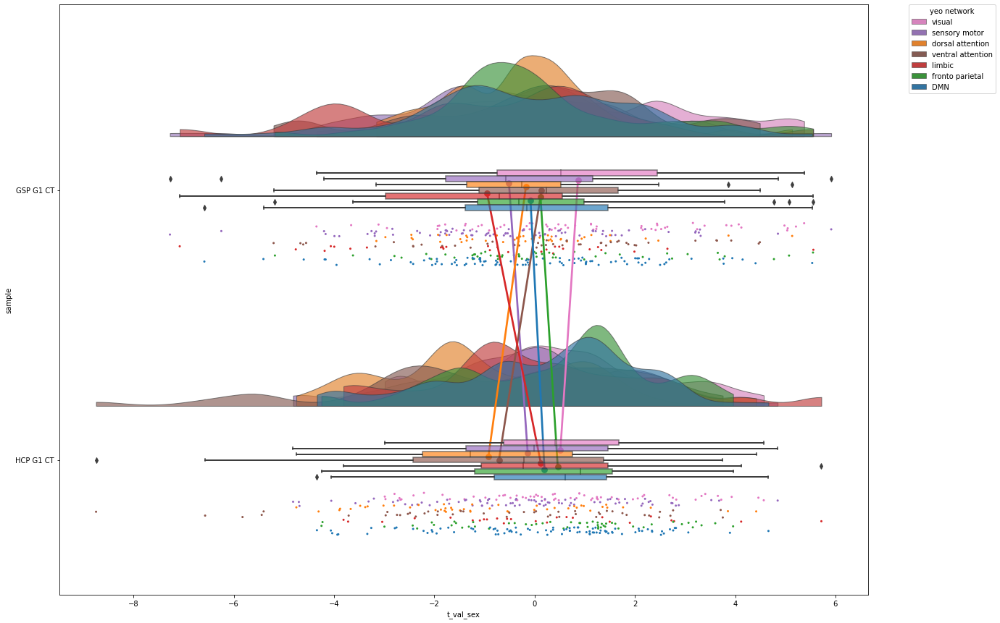

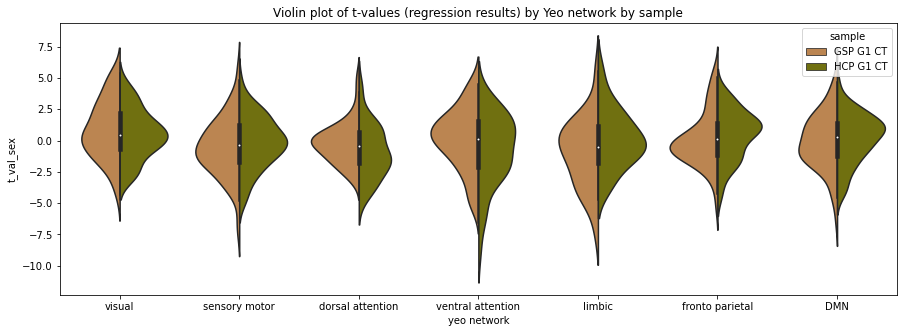

In [111]:
RainCloudPlot_YeoNetworks_SampleComparison_tval(reg_res_sample_1 = GSP_R_lm_ct_G1_sex_contrast_res, reg_res_sample_2 = HCP_R_lmer_ct_G1_sex_contrast_res, sample_1_label = "GSP G1 CT", sample_2_label = "HCP G1 CT")

### G2

#### Correlation t-values

Overall Pearson correlation between GSP sex contrast G2 CT t-values and HCP sex contrast G2 CT t-values: r = 0.36; p = 0.0

visual: r = 0.28, p = 0.032
sensory motor: r = 0.63, p = 0.0
dorsal attention: r = 0.02, p = 0.873
ventral attention: r = 0.42, p = 0.004
limbic: r = 0.08, p = 0.704
fronto parietal: r = 0.22, p = 0.12
DMN: r = 0.39, p = 0.0




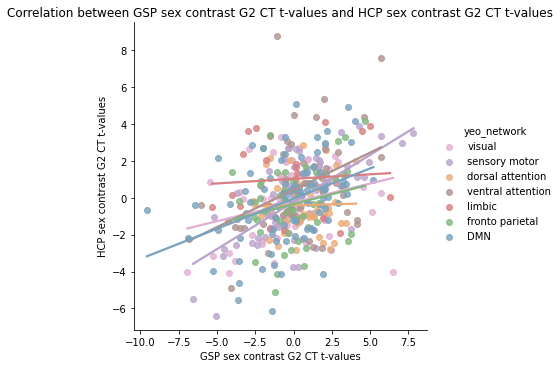

In [112]:
print_plot_corr_networks(x = GSP_R_lm_ct_G2_sex_contrast_res.t_val_sex, y = HCP_R_lmer_ct_G2_sex_contrast_res.t_val_sex, x_label = 'GSP sex contrast G2 CT t-values', y_label = 'HCP sex contrast G2 CT t-values')

#### Spin permutation test (for correlation of t-values)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.004


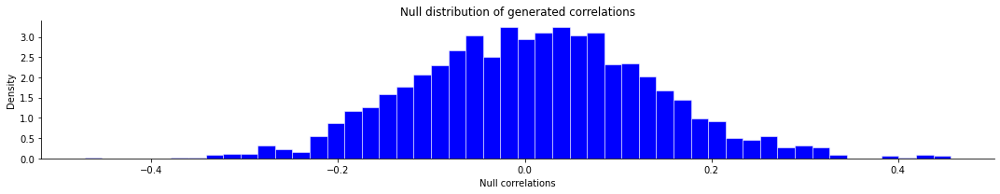

In [113]:
SpinPermutationTest_PearsonCorr_Schaefer400(x = GSP_R_lm_ct_G2_sex_contrast_res.t_val_sex, y = HCP_R_lmer_ct_G2_sex_contrast_res.t_val_sex)

### Comparing parcels showing statistically significant sex differences between datasets

Number of parcels that show statistically significant sex differences across datasets: 35
Number of parcels that show statistically significant sex differences in GSP G2 CT only: 74
Number of parcels that show statistically significant sex differences in HCP G2 CT only: 48
Number of parcels (out of the 35 parcels that show sig sex differences in both datasets) which show sex differences in opposite directions: 5



'Overlap of significant sex differences: 2 (dark green): significant in both samples, 1 (light green): significant in one sample, 0: not significant'

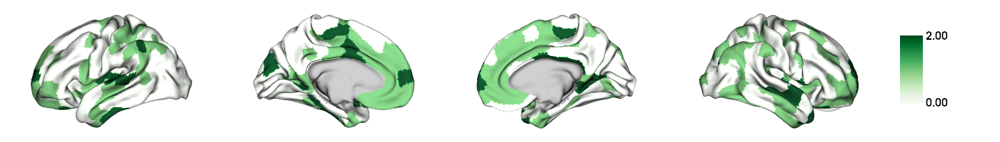

'Which dataset shows significant sex difference: +1 (purple) GSP G2 CT, -1 (brown) = HCP G2 CT, 0 (white) = both datasets, nan (grey) = not significant in any dataset'

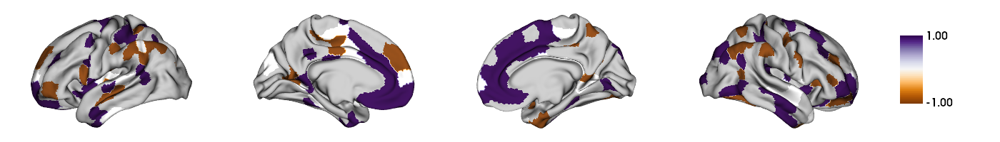

'Parcels showing sex differences in opposite directions'

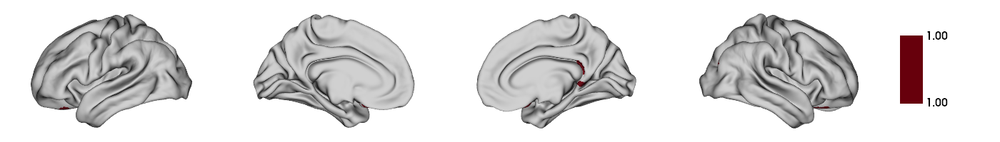

In [114]:
plots_to_display = plot_sig_overlap(reg_res_sample_1 = GSP_R_lm_ct_G2_sex_contrast_res, reg_res_sample_2 = HCP_R_lmer_ct_G2_sex_contrast_res, sample_1_label = "GSP G2 CT", sample_2_label = "HCP G2 CT")
display(*plots_to_display)

#### Visualizing t-values of sex contrast in unimodal-heteromodal gradient by network

Minimum positive significant t-value in GSP G2 CT: 2.64
Minimum negative significant t-value in GSP G2 CT: -2.47

Number of positive significant t-values (M > F (gradient loadings)) in GSP G2 CT: 54 -> by network: {'visual': 6, 'sensory motor': 10, 'dorsal attention': 7, 'ventral attention': 8, 'limbic': 6, 'fronto parietal': 8, 'DMN': 9}
Number of negative significant t-values (F > M (gradient loadings)) in GSP G2 CT: 55 -> by network: {'visual': 10, 'sensory motor': 8, 'dorsal attention': 1, 'ventral attention': 8, 'limbic': 6, 'fronto parietal': 5, 'DMN': 17}


Minimum positive significant t-value in HCP G2 CT: 2.58
Minimum negative significant t-value in HCP G2 CT: -2.59

Number of positive significant t-values (M > F (gradient loadings)) in HCP G2 CT: 44 -> by network: {'visual': 3, 'sensory motor': 9, 'dorsal attention': 2, 'ventral attention': 9, 'limbic': 6, 'fronto parietal': 5, 'DMN': 10}
Number of negative significant t-values (F > M (gradient loadings)) in HCP G2 CT: 39 -> 

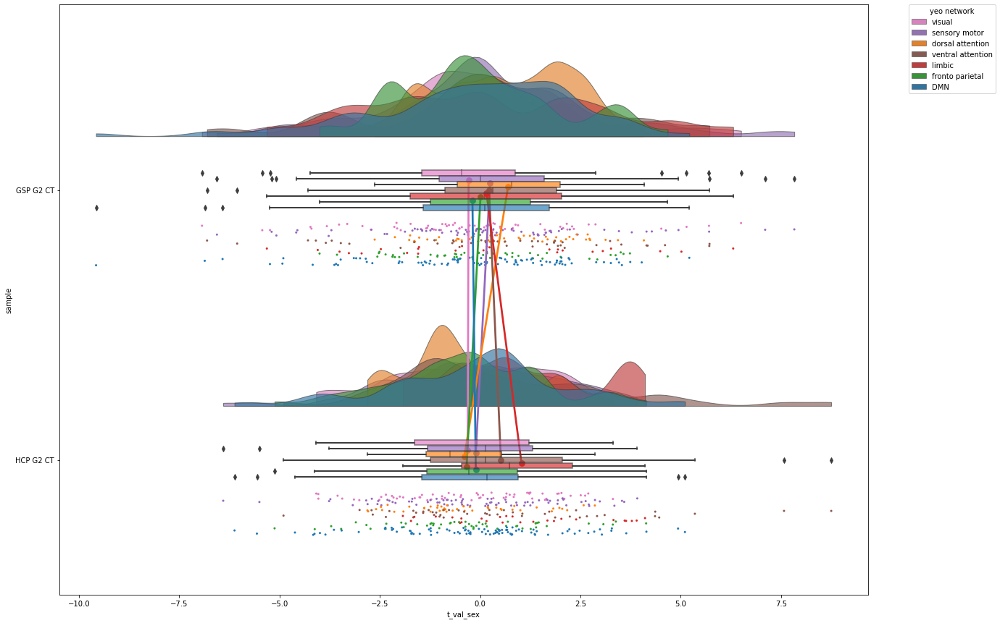

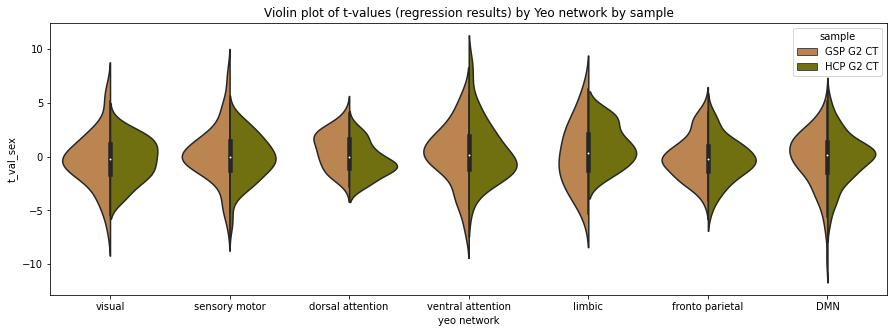

In [115]:
RainCloudPlot_YeoNetworks_SampleComparison_tval(reg_res_sample_1 = GSP_R_lm_ct_G2_sex_contrast_res, reg_res_sample_2 = HCP_R_lmer_ct_G2_sex_contrast_res, sample_1_label = "GSP G2 CT", sample_2_label = "HCP G2 CT")